### Imports:

In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from PIL import Image
import os

In [2]:
import cv2
import skimage
from scipy.ndimage import binary_fill_holes
from skimage import img_as_ubyte
from skimage.color import rgb2gray, rgb2hsv
from skimage.exposure import equalize_hist, histogram
from skimage.feature import canny
from skimage.filters import threshold_otsu, unsharp_mask, gaussian
from skimage.measure import find_contours, approximate_polygon
from skimage.morphology import (dilation, erosion, binary_closing, binary_opening,
                                remove_small_objects, thin, convex_hull_image, square, disk, diamond)
from skimage.util import invert

from tqdm import tqdm

### Functions:

In [3]:
def to_1ch(img, mode='gray'):
    transf_1ch = (
        {'r': lambda img: img[:, :, 0],
         'g': lambda img: img[:, :, 1],
         'b': lambda img: img[:, :, 2],
         'h': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 0]),
         's': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 1]),
         'v': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 2]),
         'gray': lambda img: img_as_ubyte(rgb2gray(img))}
    )
    return transf_1ch[mode](img)

In [4]:
def to_bin(img, thr='otsu'):
    if thr == 'otsu':
        return img > threshold_otsu(img)
    else:
        return img > 255 * thr

In [5]:
def to_bin_uint8(img):
    return img.astype(np.uint8) * 255

In [6]:
def list_get(list_, ind_, default_):
  try:
    return list_[ind_]
  except IndexError:
    return default_

In [7]:
def set_padding(img, num, val):
    if num > 0:
        h, w = img.shape
        new_img = np.full((h + 2 * num, w + 2 * num), val)
        new_img[num:-num, num:-num] = img
        img = new_img.astype(img.dtype)
    elif num < 0:
        num = -num
        img = img[num:-num, num:-num]
    return img

In [8]:
def resize_prop(img, max_size):
    h, w = img.shape[:2]
    img_max_size = max(w, h)
    if max_size < img_max_size:
        ratio = img_max_size / max_size
        w, h = int(w / ratio), int(h / ratio)
        
        img = cv2.resize(img, (w, h),
                         interpolation=cv2.INTER_AREA)
    return img

In [9]:
def show_images(img_arr, name_arr=[], n_in_row=2, factor_r=6, factor_c=8, figsize=None,
         title=None, cmap_='Greys', label_fontsize=14, tick_fontsize=16, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        if type(img) is tuple:
            if len(img) == 1:
                img[0].show()
            else:
                x, y = img
                ax.plot(x, y)
                ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        else:
            ax.imshow(img, cmap=cmap_)
            ax.xaxis.set_ticks_position('top')
            ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
#         plt.savefig(f'{save_path}.jpg')
        plt.savefig(f'{save_path}.pdf')
    for i, img in enumerate(img_arr):  
        ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize, labelpad=10)
    plt.show()

In [10]:
def show_image_cv(img, name=''):
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img = resize_prop(img, 700)
    cv2.imshow(name, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

### Input:

In [285]:
src_images = []

input_folder = 'input'
src_names = os.listdir(input_folder)

In [286]:
for name in tqdm(src_names):
    img = cv2.imread(f'{input_folder}/{name}')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    src_images.append(np.array(img))

100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 282.74it/s]


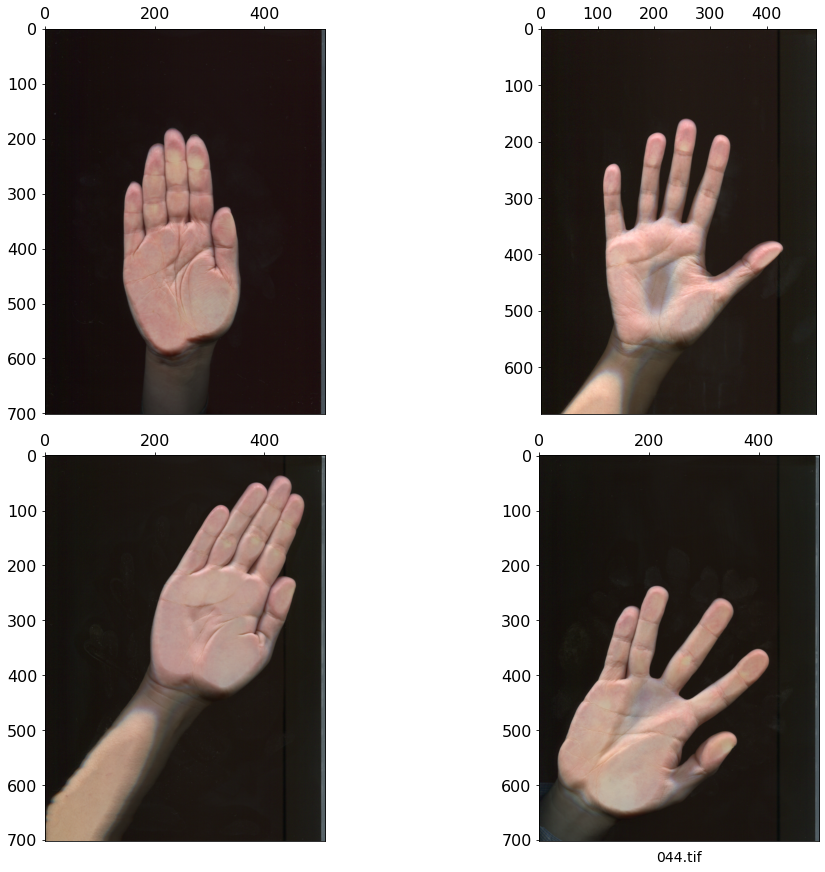

In [287]:
show_images(src_images, src_names)

### Hand palm segmentation:

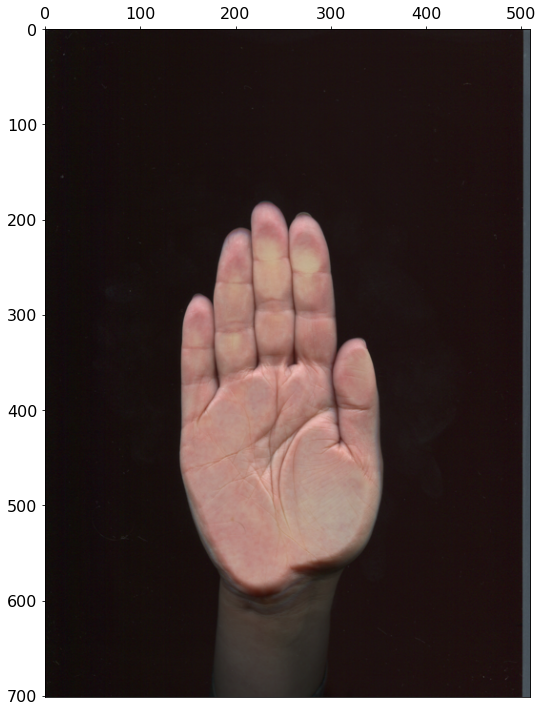

In [14]:
img = src_images[0]
show_images([img], factor_r=10, factor_c=12)

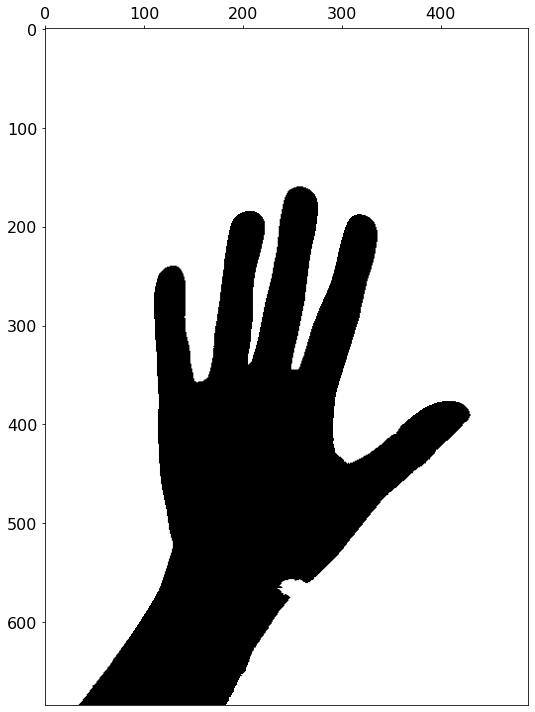

In [15]:
def get_palm_mask(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, img = cv2.threshold(img, 40, 255, cv2.THRESH_BINARY)
    img = img > 0

    pad_val = 30

    img = set_padding(img, pad_val, False) > 0
    img = remove_small_objects(img, 1200, connectivity=2)
    img = set_padding(img, -pad_val, False) > 0
    return img

mask = get_palm_mask(img)
show_images([mask], factor_r=10, factor_c=12)

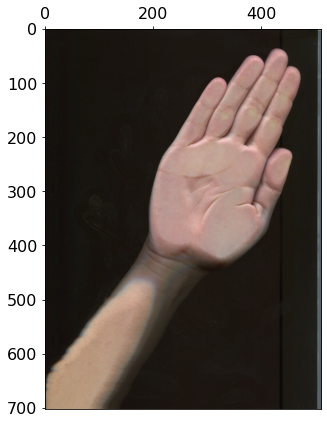

In [16]:
show_images([src_images[1]])

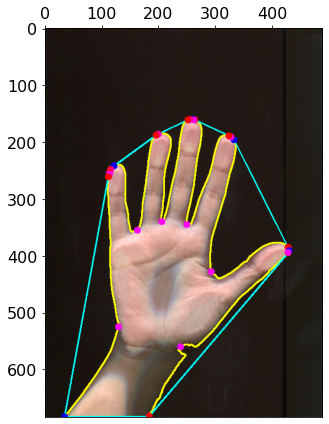

In [17]:
def get_palm_mask(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, img = cv2.threshold(img, 40, 255, cv2.THRESH_BINARY)
    img = img > 0

    pad_val = 30

    img = set_padding(img, pad_val, False) > 0
#     img = binary_closing(img, disk(5))
    img = remove_small_objects(img, 10000, connectivity=2)
    img = set_padding(img, -pad_val, False) > 0
    return img

img = np.copy(src_images[0])
mask = get_palm_mask(img)

# show_images([mask])
# assert 1 == 0

# reading image and mask
main_img = img.copy()
# main_img = cv2.cvtColor(main_img, cv2.COLOR_RGB2BGR)
main_mask = mask.copy()
# show_images([main_mask])
main_mask = to_bin_uint8(main_mask)

contours, _ = cv2.findContours(main_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)[-2:]
contour = contours[np.argmax([len(contour) for contour in contours])]
cv2.drawContours(main_img, [contour], 0, [255, 255, 0], 2)
# show_images([main_img])

hull = cv2.convexHull(contour)
cv2.drawContours(main_img, [hull], 0, [0, 255, 255], 2)
# show_images([main_img])

hull_inds = cv2.convexHull(contour, returnPoints=False)
defects = cv2.convexityDefects(contour, hull_inds)
# print(len(defects))

# assert 0 == 1


for i in range(defects.shape[0]):
    s,e,f,d = defects[i,0]
#     print(contour[s])
    start = tuple(contour[s][0])
    end = tuple(contour[e][0])
    far = tuple(contour[f][0])
#     cv2.line(main_img,start,end,[0,255,0],2)
#     cv2.circle(main_img,far,6,[255,0,0],-1)
    cv2.circle(main_img,start,6,[255,0,0],-1)
    cv2.circle(main_img,end,6,[0,0,255],-1)
    cv2.circle(main_img,far,6,[255,0,255],-1)
#     cv2.line(main_img,start,far,[255,255,255],3)
#     cv2.line(main_img, far,end,[255,255,255],2)
    
#     a = 
    
#     a = math.sqrt((end[0] - start[0]) ** 2 + (end[1] - start[1]) ** 2)
#     b = math.sqrt((far[0] - start[0]) ** 2 + (far[1] - start[1]) ** 2)
#     c = math.sqrt((end[0] - far[0]) ** 2 + (end[1] - far[1]) ** 2)
#     angle = math.acos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))  # cosine theorem
#     if angle <= math.pi / 2:  # angle less than 90 degree, treat as fingers
#         cnt += 1
#         cv2.circle(drawing, far, 8, [211, 84, 0], -1)
    
#     show_images([main_img])
#     assert 1==0
show_images([main_img])

=================

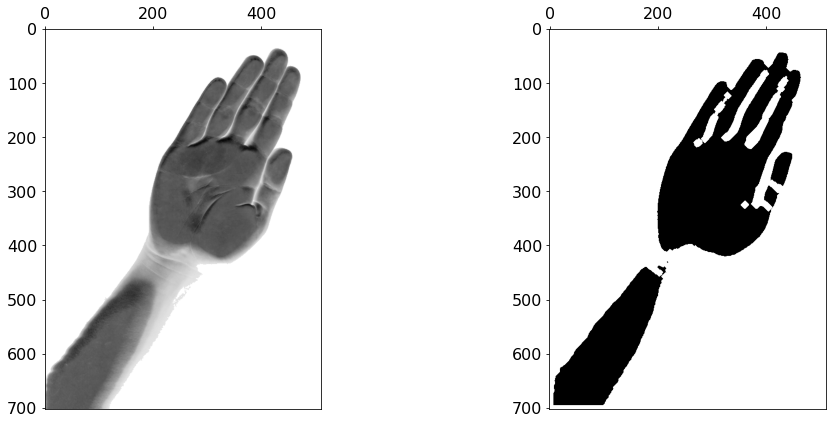

In [125]:
def get_palm_mask(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, img = cv2.threshold(img, 40, 255, cv2.THRESH_BINARY)
    img = img > 0

    pad_val = 30

    img = set_padding(img, pad_val, False) > 0
#     img = binary_closing(img, disk(5))
    img = remove_small_objects(img, 10000, connectivity=2)
    img = set_padding(img, -pad_val, False) > 0
    return img

img = np.copy(src_images[1])
mask = get_palm_mask(img)

img2 = np.copy(src_images[1])
one_ch = to_1ch(img2, 'b') * mask
mask2 = to_bin(one_ch, 0.3)
# mask2 = erosion(mask2, disk(2))
mask2 = thin(mask2, 5)
mask2 = erosion(mask2, disk(2))

# _, mask2 = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)
show_images([gray, mask2])

# show_images([img, mask], n_in_row=2, factor_r = 16, factor_c = 14)
# show_images([img2, mask2], n_in_row=2, factor_r = 16, factor_c = 14)
# assert 1 == 0

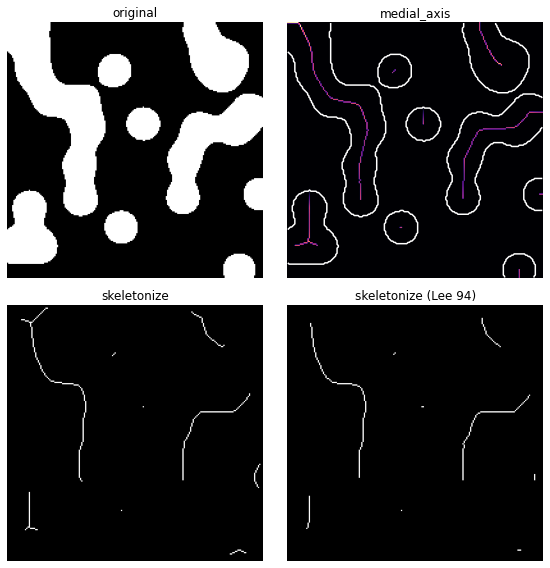

In [85]:
import skimage
from skimage.morphology import medial_axis, skeletonize

# Generate the data
blobs = skimage.data.binary_blobs(200, blob_size_fraction=.2,
                          volume_fraction=.35, seed=1)

# Compute the medial axis (skeleton) and the distance transform
skel, distance = medial_axis(blobs, return_distance=True)

# Compare with other skeletonization algorithms
skeleton = skeletonize(blobs)
skeleton_lee = skeletonize(blobs, method='lee')

# Distance to the background for pixels of the skeleton
dist_on_skel = distance * skel

fig, axes = plt.subplots(2, 2, figsize=(8, 8), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(blobs, cmap=plt.cm.gray)
ax[0].set_title('original')
ax[0].axis('off')

ax[1].imshow(dist_on_skel, cmap='magma')
ax[1].contour(blobs, [0.5], colors='w')
ax[1].set_title('medial_axis')
ax[1].axis('off')

ax[2].imshow(skeleton, cmap=plt.cm.gray)
ax[2].set_title('skeletonize')
ax[2].axis('off')

ax[3].imshow(skeleton_lee, cmap=plt.cm.gray)
ax[3].set_title("skeletonize (Lee 94)")
ax[3].axis('off')

fig.tight_layout()
plt.show()

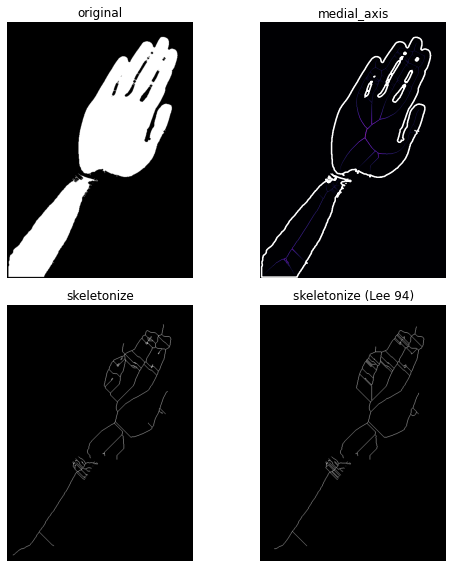

In [86]:
# Generate the data
blobs = mask2

# Compute the medial axis (skeleton) and the distance transform
skel, distance = medial_axis(blobs, return_distance=True)

# Compare with other skeletonization algorithms
skeleton = skeletonize(blobs)
skeleton_lee = skeletonize(blobs, method='lee')

# Distance to the background for pixels of the skeleton
dist_on_skel = distance * skel

fig, axes = plt.subplots(2, 2, figsize=(8, 8), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(blobs, cmap=plt.cm.gray)
ax[0].set_title('original')
ax[0].axis('off')

ax[1].imshow(dist_on_skel, cmap='magma')
ax[1].contour(blobs, [0.5], colors='w')
ax[1].set_title('medial_axis')
ax[1].axis('off')

ax[2].imshow(skeleton, cmap=plt.cm.gray)
ax[2].set_title('skeletonize')
ax[2].axis('off')

ax[3].imshow(skeleton_lee, cmap=plt.cm.gray)
ax[3].set_title("skeletonize (Lee 94)")
ax[3].axis('off')

fig.tight_layout()
plt.show()

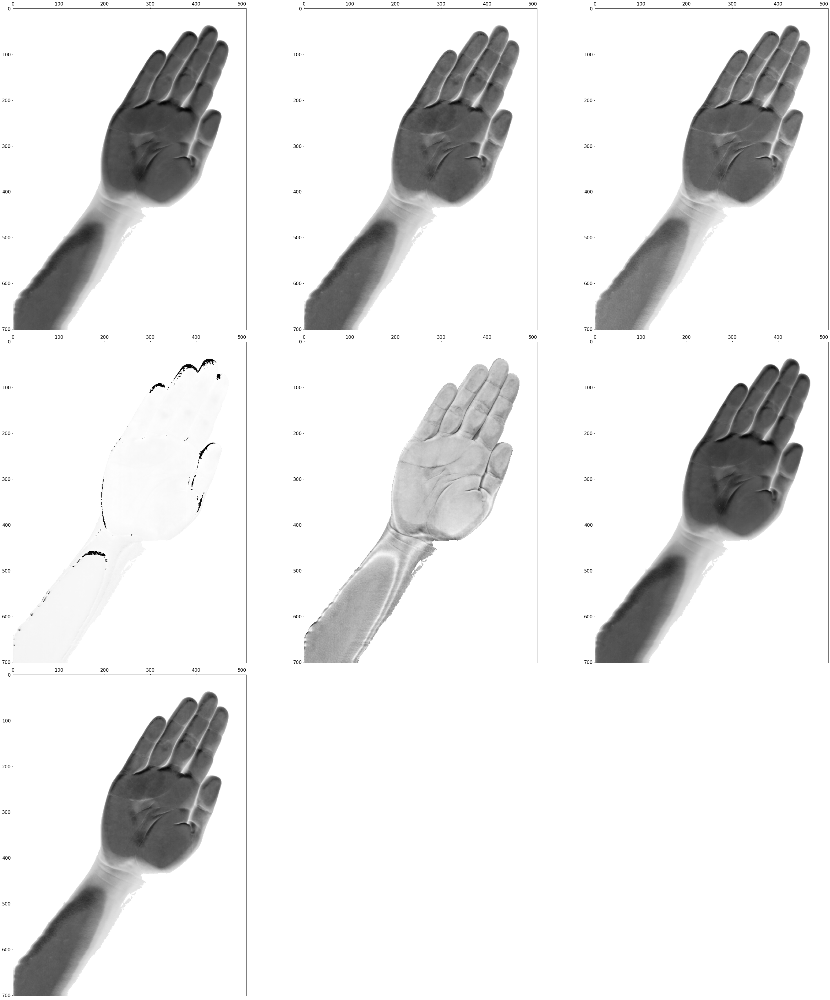

In [35]:
show_images([mask * to_1ch(img, mode=mode) for mode in ['r', 'g', 'b', 'h', 's', 'v', 'gray']], n_in_row=3, factor_r = 16, factor_c = 14)

### Skeleton Idea

In [303]:
def img_sub(img1, img2):
    src_dtype = img1.dtype
    img1, img2 = list(map(lambda x: x.astype(np.int32), [img1, img2]))

    img = img1 - img2
    img[img < 0] = 0

    img = img.astype(src_dtype)
    return img

def sharpen(img, size, count):
    img_blur = cv2.GaussianBlur(img, (size,size), 0)
    img = cv2.addWeighted(img, count + 1, img_blur, -count, 0)
    return img

def show_images_cv(img_arr, name_arr=[]):
    for i, img in enumerate(img_arr):
        if len(img.shape) == 3:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        img = resize_prop(img, 700)
        cv2.imshow(list_get(name_arr, i, ''), img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

def get_mask_2(img):
    img = to_1ch(img, 'r')
    img = sharpen(img, 3, 10)
#     show_image_cv(img)

    # bin = to_bin_uint8(to_bin(img))
    _, bin = cv2.threshold(img, 80, 255, cv2.THRESH_BINARY)
#     show_image_cv(bin)

    # bin = to_bin_uint8(binary_opening(bin, disk(10)))
    bin = bin > 0
    # bin = to_bin_uint8(binary_opening(bin, disk(10)))
    bin = to_bin_uint8(erosion(bin, disk(2)))
    # bin = to_bin_uint8(thin(bin, 2))
    bin = to_bin_uint8(binary_closing(bin, disk(1)))
    bin = to_bin_uint8(binary_fill_holes(bin, disk(1)))
#     show_image_cv(bin)
    # _, bin = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)
    # show_image_cv(bin)
    return bin

def get_mask_1(img):
    img = to_1ch(img, 'r')
#     show_image_cv(img)

    blur = cv2.GaussianBlur(img, (3,3), 0)
    # show_image_cv(img)

    img_for_edge = img
    v, s, w = 2, 3, 1.2
    grad_x = cv2.Sobel(img_for_edge, cv2.CV_64F, v, 0, ksize=s)
    grad_y = cv2.Sobel(img_for_edge, cv2.CV_64F, 0, v, ksize=s)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    grad = cv2.addWeighted(abs_grad_x, w, abs_grad_y, w, 0)

    grad = cv2.dilate(grad, disk(1))
#     show_image_cv(grad)
    img_1 = img_sub(img, grad)
#     show_image_cv(img_1)
    img_2 = to_bin_uint8(to_bin(img_1))
    img_2 = to_bin_uint8(binary_fill_holes(img_2, disk(1)))
#     show_image_cv(img_2)
    # show_images([img_1, img_2])

    # grad2 = cv2.dilate(grad, disk(1))
    # grad2 = cv2.dilate(grad, square(5))
    # show_image_cv(grad2)
    # show_image_cv(img_sub(img, grad2))
    return img_2

img = np.copy(src_images[3])
mask_1 = get_mask_1(img)
mask_2 = get_mask_2(img)
show_images_cv([mask_1, mask_2, mask_1 + mask_2], ['1', '2', '1 + 2'])

We got masks

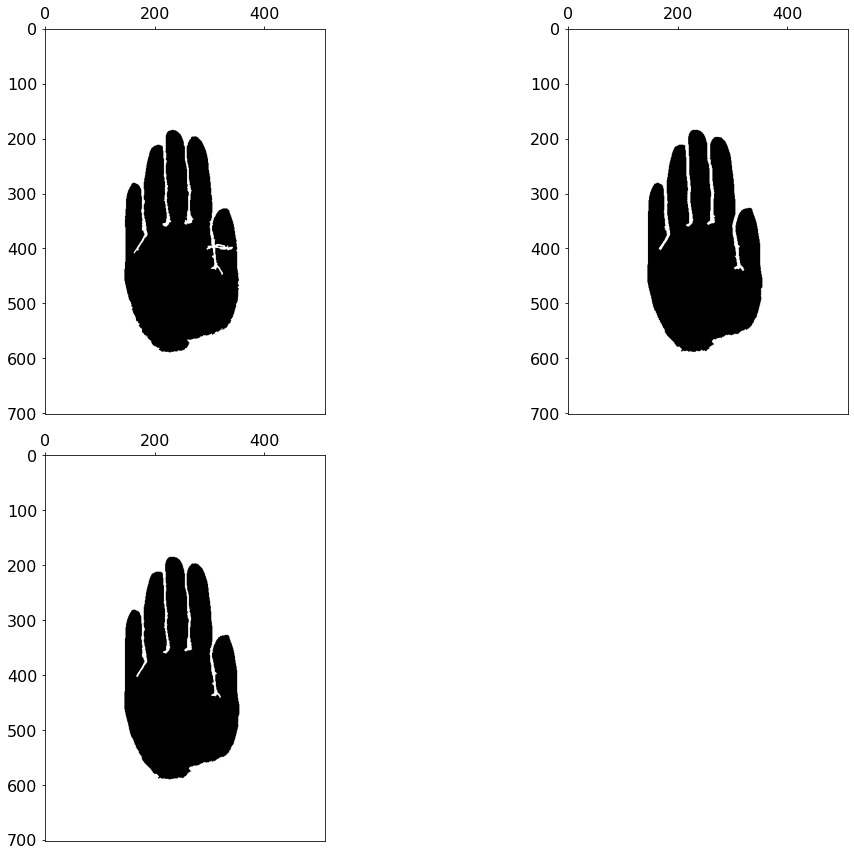

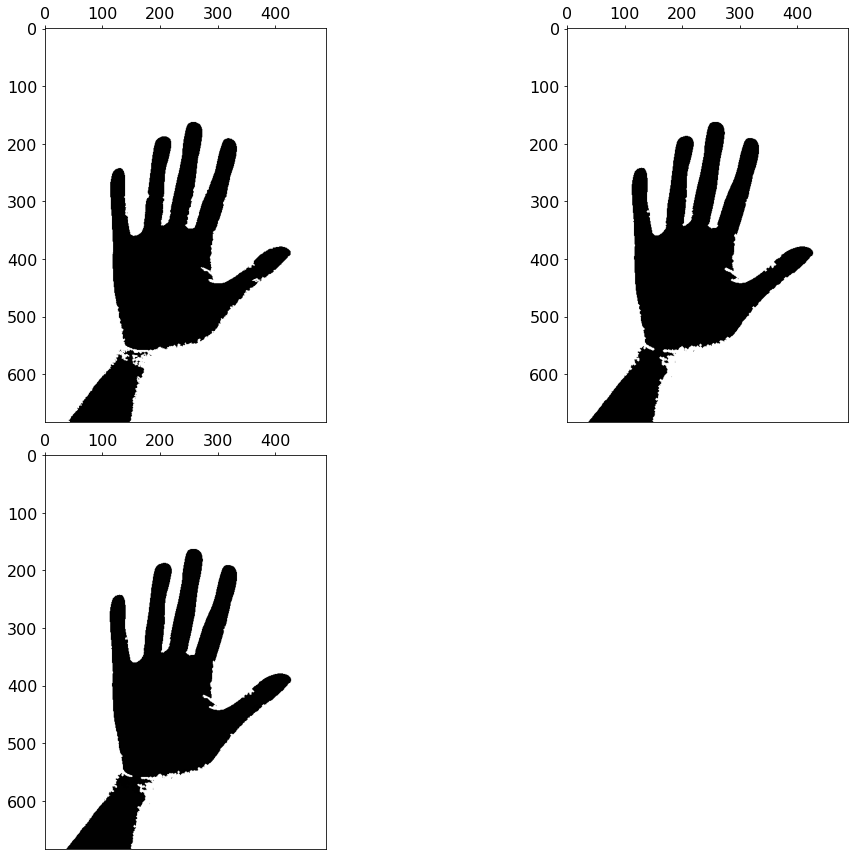

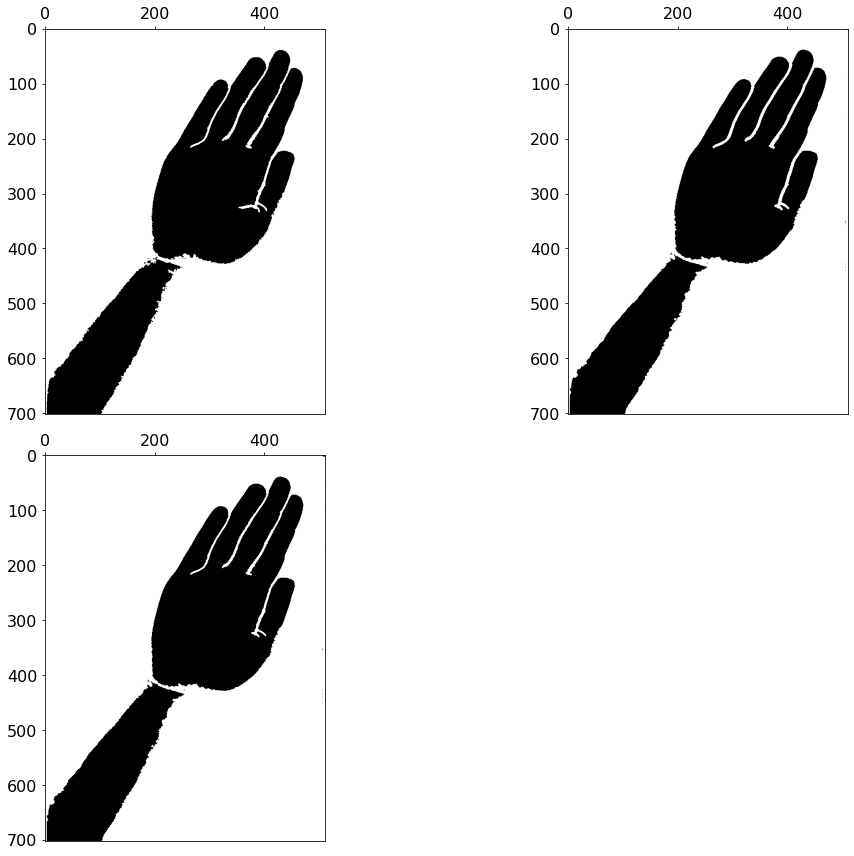

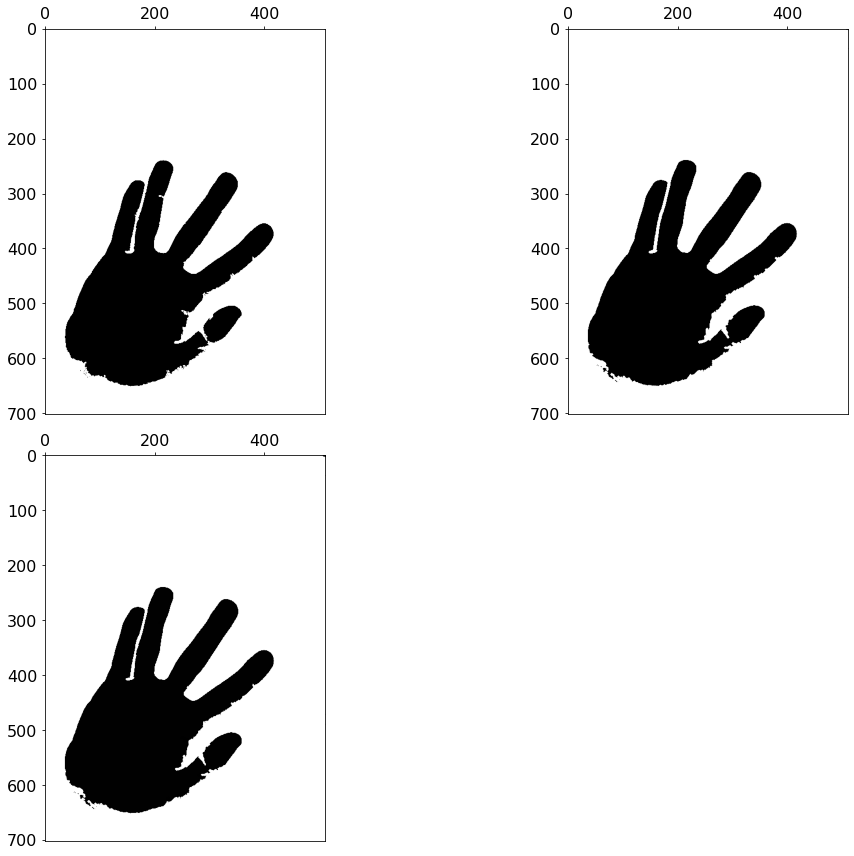

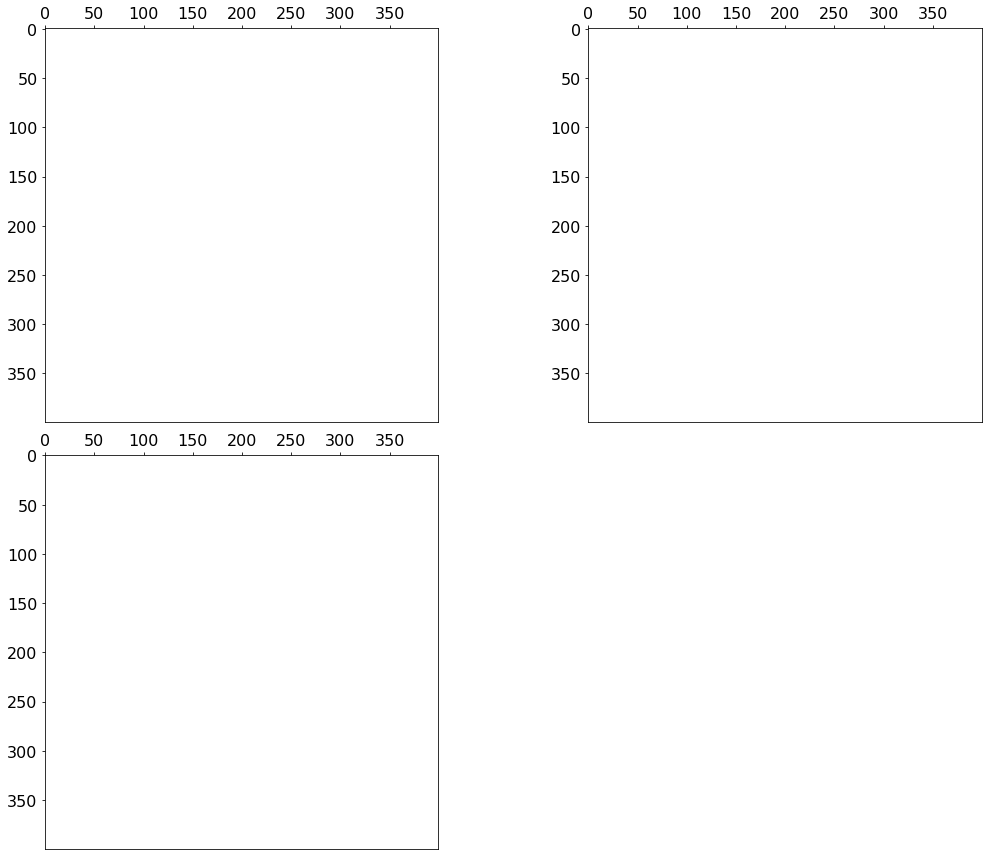

In [17]:
for img in src_images:
    mask_1 = get_mask_1(img)
    mask_2 = get_mask_2(img)
    show_images([mask_1, mask_2, mask_1 + mask_2])

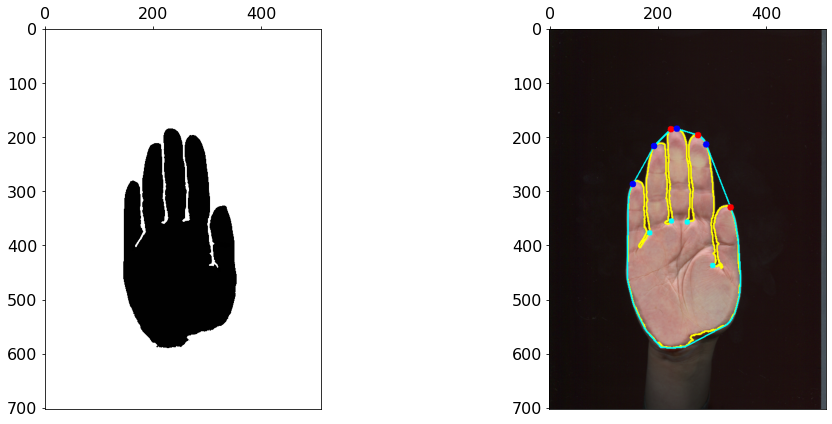

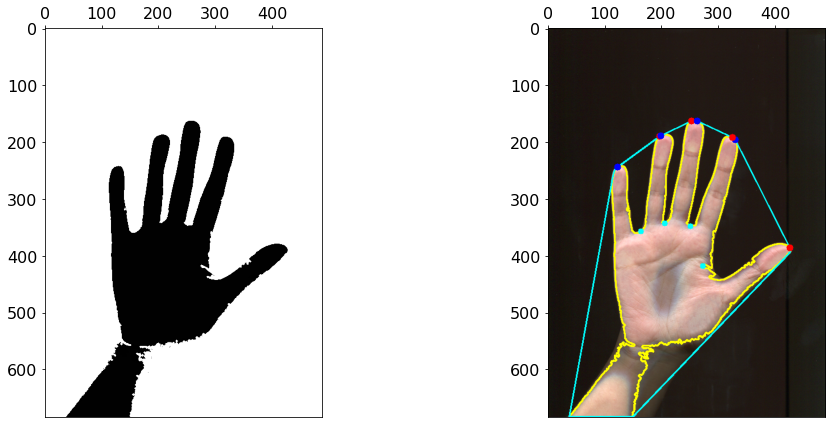

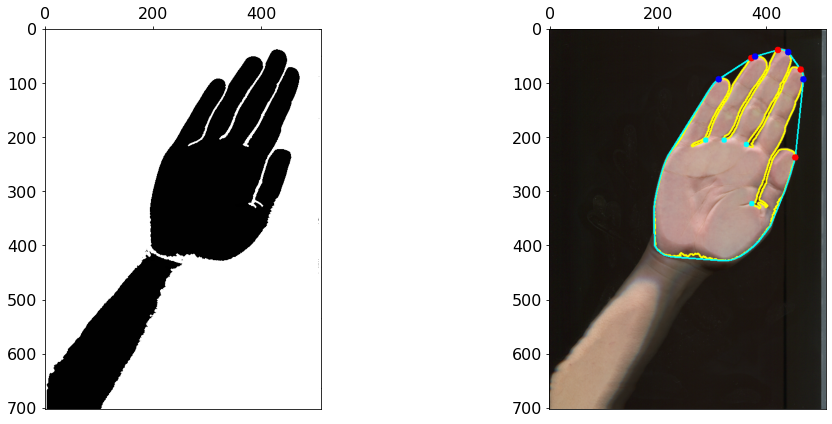

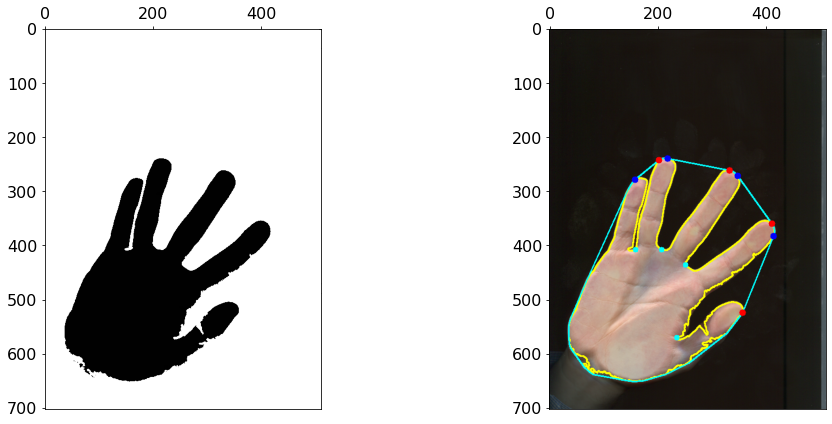

In [57]:
for img in src_images[:-1]:
    img = np.copy(img)
    mask = get_mask_1(img) + get_mask_2(img)
    get_points(img, mask)

In [56]:
def get_points(img, mask):
    main_img = img.copy()
    # main_img = cv2.cvtColor(main_img, cv2.COLOR_RGB2BGR)
    main_mask = mask.copy()
    # show_images([main_mask])
    main_mask = to_bin_uint8(main_mask)

    contours, _ = cv2.findContours(main_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)[-2:]
    contour = contours[np.argmax([len(contour) for contour in contours])]
    cv2.drawContours(main_img, [contour], 0, [255, 255, 0], 2)
    # show_images([main_img])

    hull = cv2.convexHull(contour)
    cv2.drawContours(main_img, [hull], 0, [0, 255, 255], 2)
    # show_images([main_img])

    hull_inds = cv2.convexHull(contour, returnPoints=False)
    defects = cv2.convexityDefects(contour, hull_inds)
    # print(len(defects))

    # assert 0 == 1

    points_arr = []
    for i in range(defects.shape[0]):
        s,e,f,d = defects[i,0]
    #     print(contour[s])
        start = tuple(contour[s][0])
        end = tuple(contour[e][0])
        far = tuple(contour[f][0])
    #     cv2.line(main_img,start,end,[0,255,0],2)
    #     cv2.circle(main_img,far,6,[255,0,0],-1)
#         cv2.circle(main_img,start,6,[255,0,0],-1)
#         cv2.circle(main_img,end,6,[0,0,255],-1)
#         cv2.circle(main_img,far,6,[255,0,255],-1)
    #     cv2.line(main_img,start,far,[255,255,255],3)
    #     cv2.line(main_img, far,end,[255,255,255],2)

    #     a = 

        a = np.sqrt((end[0] - start[0]) ** 2 + (end[1] - start[1]) ** 2)
        b = np.sqrt((far[0] - start[0]) ** 2 + (far[1] - start[1]) ** 2)
        c = np.sqrt((end[0] - far[0]) ** 2 + (end[1] - far[1]) ** 2)
        angle = np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))  # cosine theorem
        if angle <= np.pi / 2:  # angle less than 90 degree, treat as fingers
            points_arr.append((d, start, end, far))
    #     show_images([main_img])
    #     assert 1==0
    points_arr = sorted(points_arr, key=lambda x: x[0])[-4:]
    for points in points_arr:
        _, start, end, far = points
        cv2.circle(main_img,start,6,[255,0,0],-1)
        cv2.circle(main_img,end,6,[0,0,255],-1)
        cv2.circle(main_img, far, 5, [0, 255, 255], -1)
    show_images([mask, main_img])

In [221]:
rrr, prrr

(array([[252, 163],
        [251, 164],
        [250, 164],
        [249, 165],
        [248, 165],
        [247, 166],
        [247, 167],
        [246, 168],
        [246, 169],
        [245, 170],
        [245, 171],
        [244, 172],
        [244, 175],
        [243, 176],
        [243, 179],
        [242, 180],
        [242, 185],
        [241, 186],
        [241, 190],
        [240, 191]], dtype=int32),
 array([252, 163], dtype=int32))

In [243]:
arr = np.argwhere(rrr == prrr)

In [249]:
s = sorted(arr, key=lambda x: x[0])

In [255]:
s = sorted(np.argwhere(rrr == prrr), key=lambda x: x[0])

ind = None
for i in range(len(s) - 1):
    if s[i][0] == s[i+1][0]:
        ind = s[i][0]

In [256]:
ind

1069

=====0=====
RIGHT
LEFT


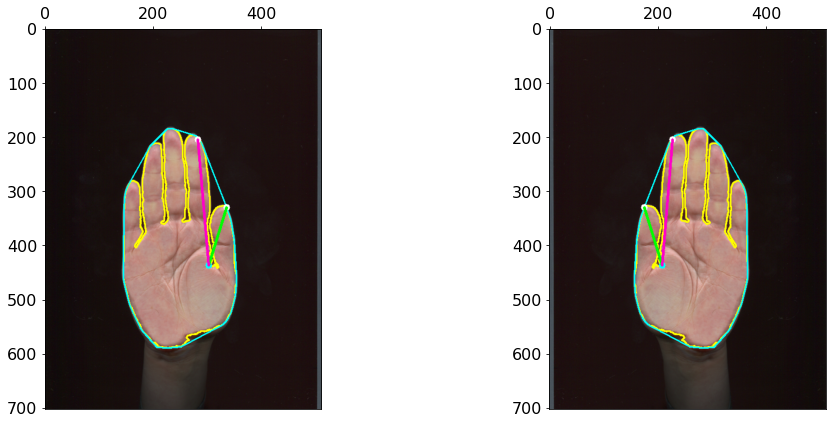

=====1=====
RIGHT
LEFT


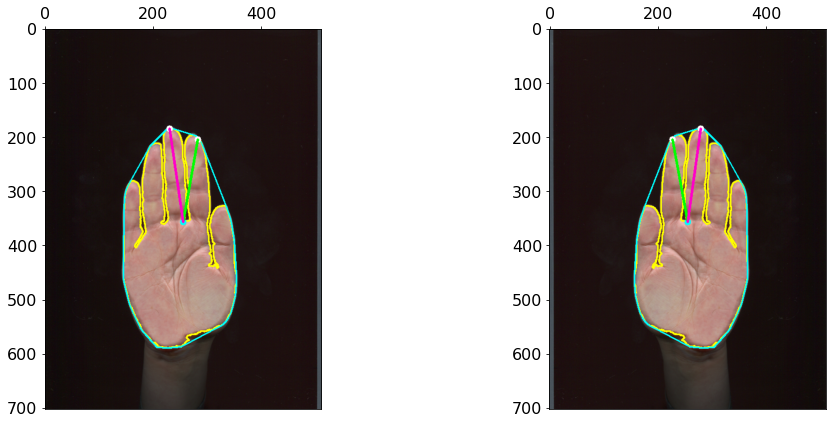

=====2=====
RIGHT
LEFT


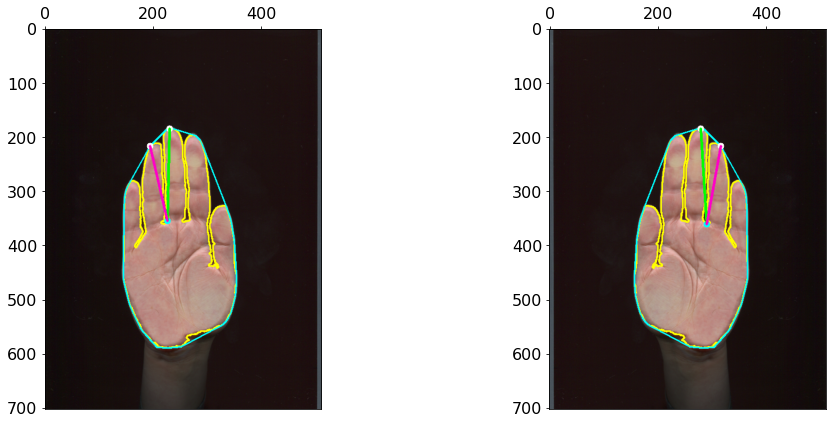

=====3=====
RIGHT
LEFT


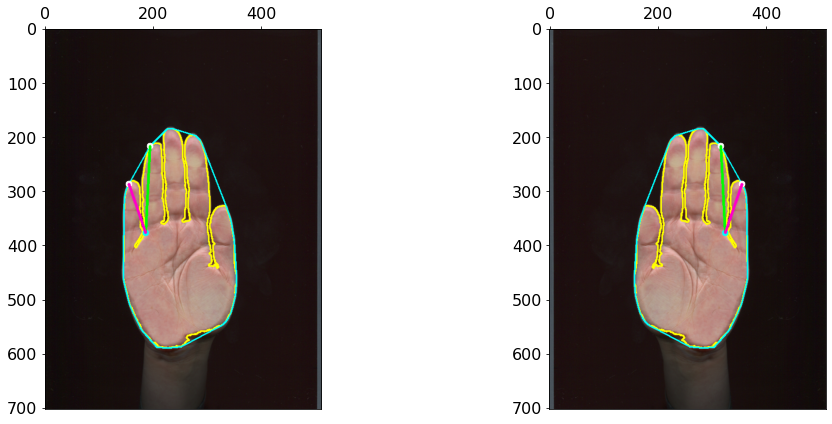

=====0=====
RIGHT
LEFT


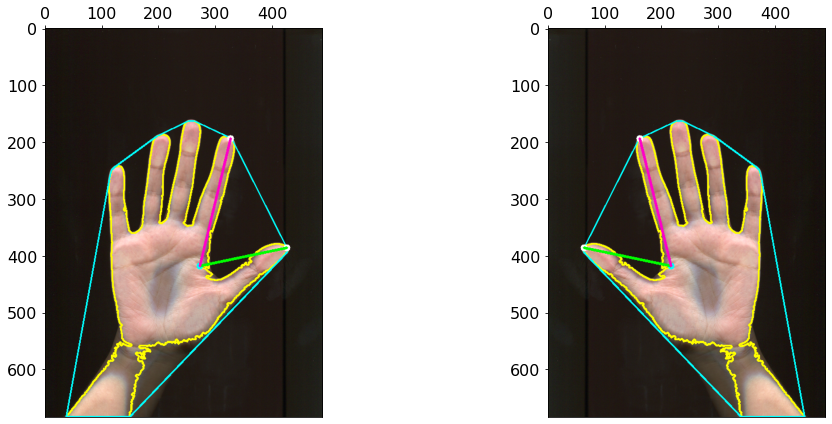

=====1=====
RIGHT
LEFT


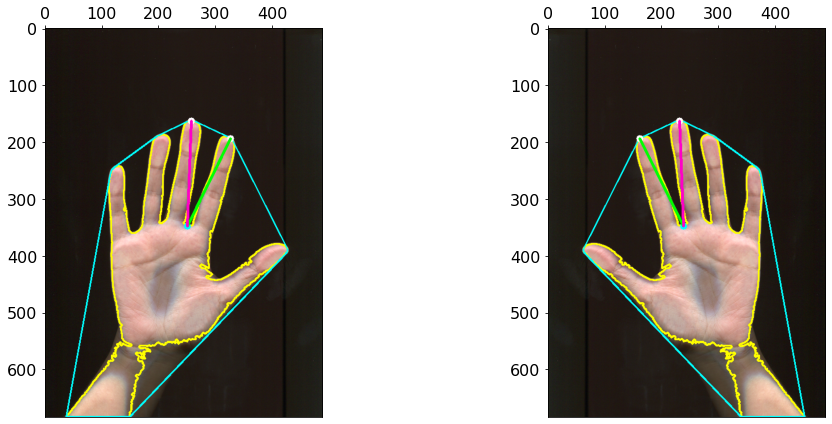

=====2=====
RIGHT
LEFT


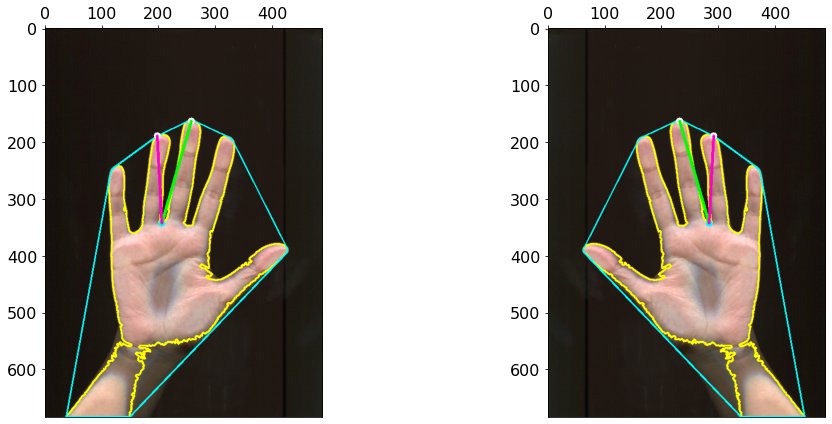

=====3=====
RIGHT
LEFT


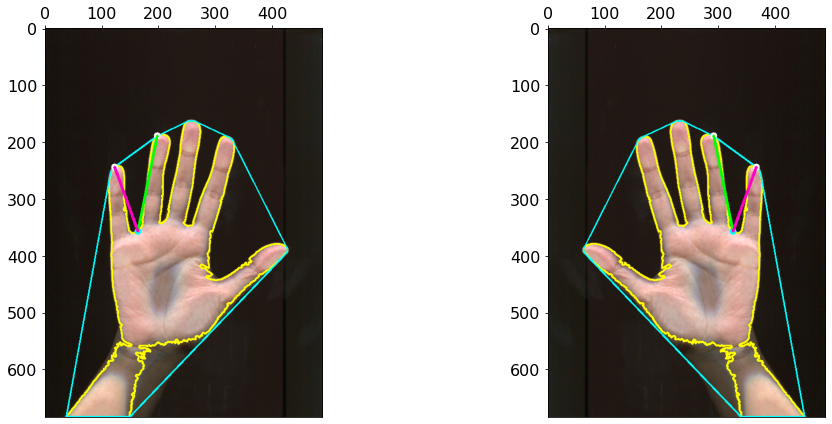

=====0=====
RIGHT
LEFT


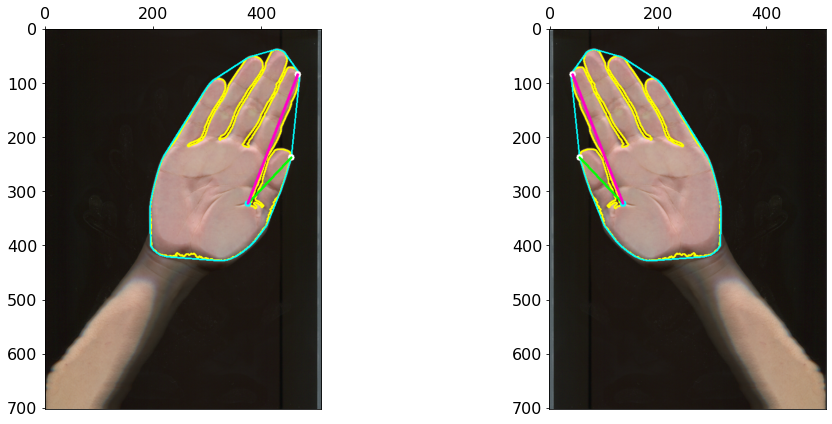

=====1=====
RIGHT
LEFT


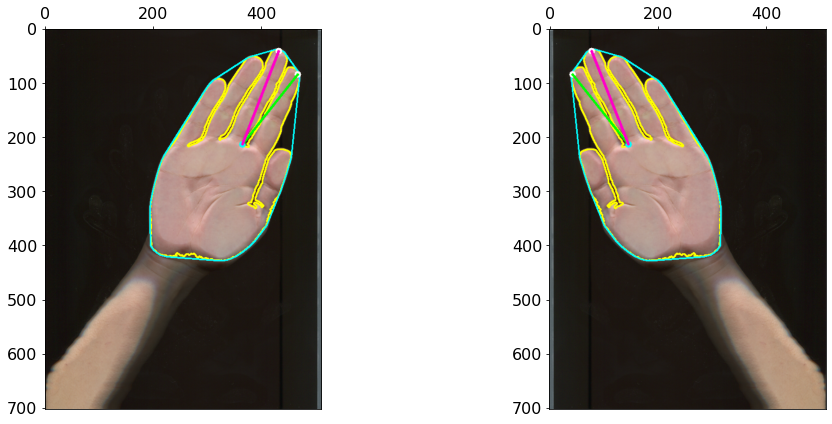

=====2=====
RIGHT
LEFT


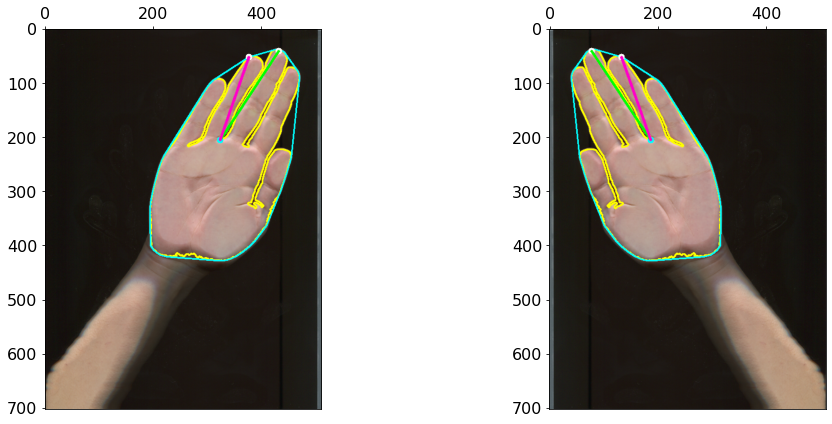

=====3=====
RIGHT
LEFT


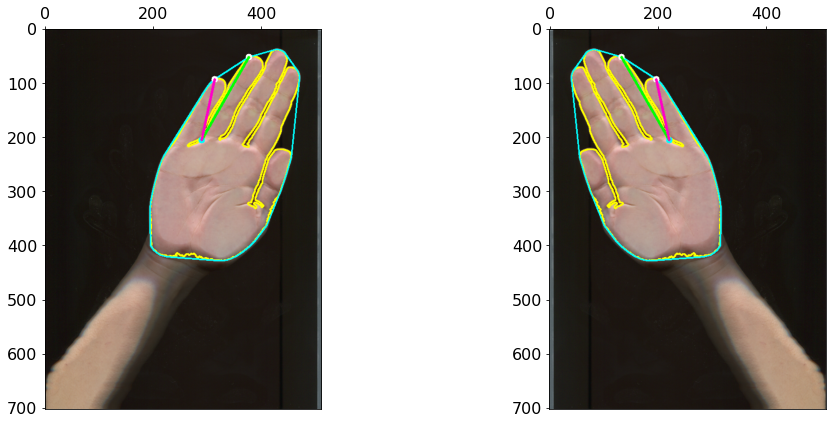

=====0=====
RIGHT
LEFT


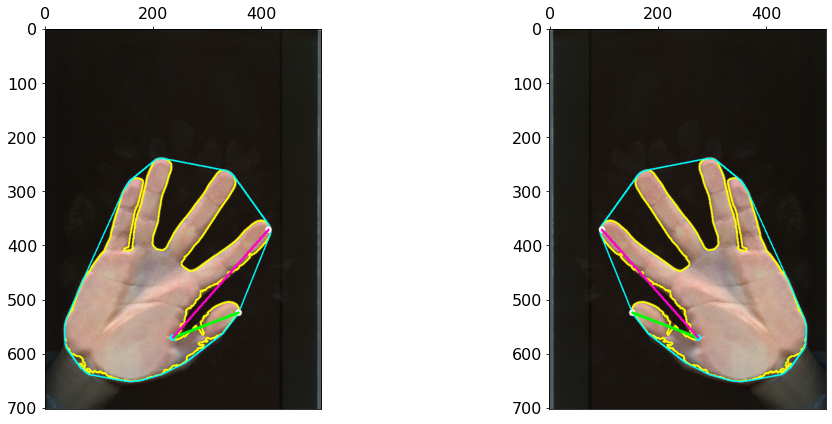

=====1=====
RIGHT
LEFT


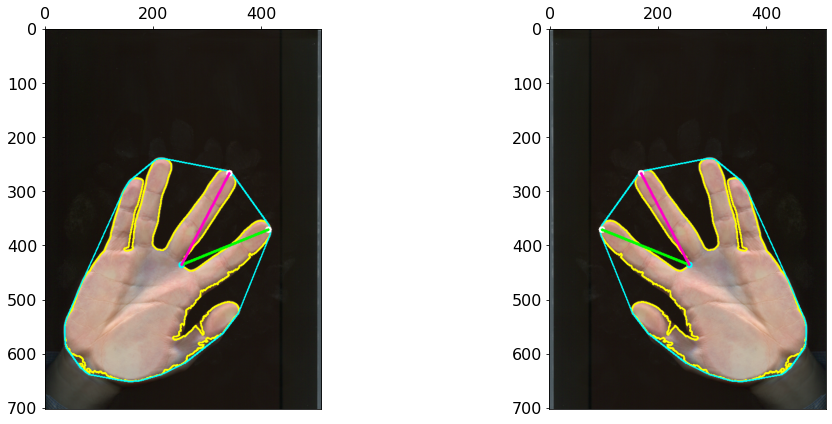

=====2=====
RIGHT
LEFT


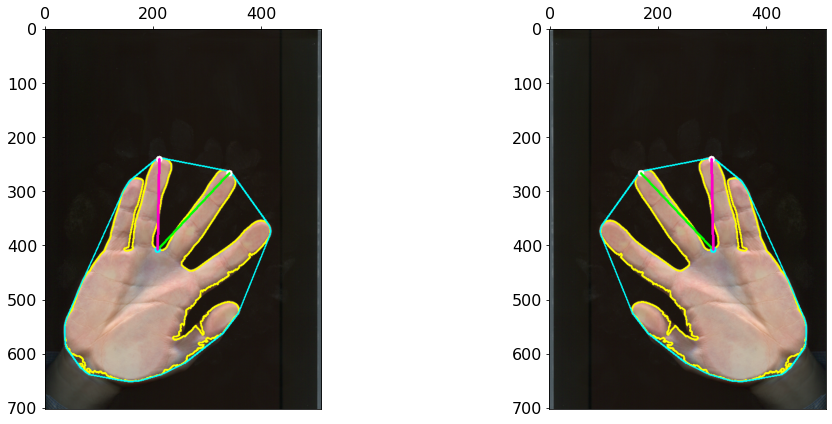

=====3=====
RIGHT
LEFT


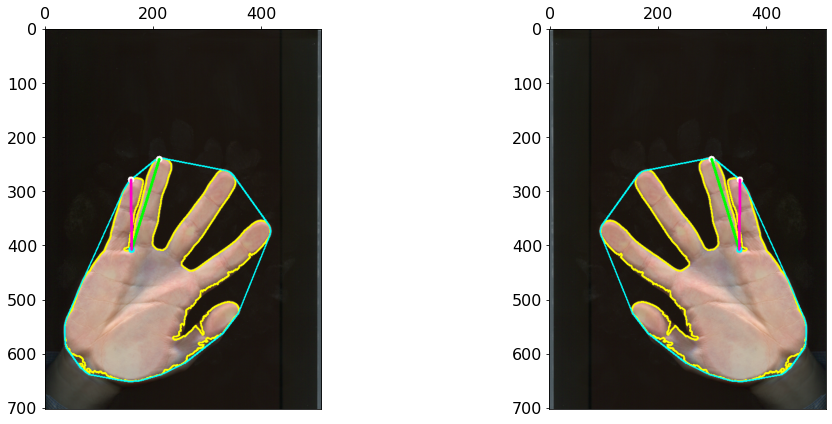

In [609]:
def dist(p1, p2):
    p1, p2 = np.array(p1), np.array(p2)
    return np.sqrt(np.sum((p1 - p2)**2, axis=-1))

def get_point_ind(arr, point):
    arr = sorted(np.argwhere(arr == point), key=lambda x: x[0])
    l = len(arr)
    for i in range(l - 1):
        if arr[i][0] == arr[i+1][0]:
            return arr[i][0]

def get_points2(img, mask, k):
    main_img = img.copy()
    # main_img = cv2.cvtColor(main_img, cv2.COLOR_RGB2BGR)
    main_mask = mask.copy()
    # show_images([main_mask])
    main_mask = to_bin_uint8(main_mask)

    contours, _ = cv2.findContours(main_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[-2:]
    contour = contours[np.argmax([len(contour) for contour in contours])]
    cv2.drawContours(main_img, [contour], 0, [255, 255, 0], 2)
#     cv2.drawContours(main_img, [contour[:20]], 0, [255, 255, 0], 2)
#     cv2.drawContours(main_img, [contour[60:100]], 0, [255, 185, 0], 2)
#     cv2.drawContours(main_img, [contour[120:160]], 0, [255, 120, 0], 2)
    # show_images([main_img])

    hull = cv2.convexHull(contour, clockwise=True,)
    cv2.drawContours(main_img, [hull], 0, [0, 255, 255], 2)
#     show_images([main_img])
#     return

    hull_inds = cv2.convexHull(contour, clockwise=True, returnPoints=False)
    defects = cv2.convexityDefects(contour, hull_inds)
    # print(len(defects))

    # assert 0 == 1

    points_arr = []
    for i in range(defects.shape[0]):
        s,e,f,d = defects[i,0]
    #     print(contour[s])
        start = tuple(contour[s][0])
        end = tuple(contour[e][0])
        far = tuple(contour[f][0])
    #     cv2.line(main_img,start,end,[0,255,0],2)
    #     cv2.circle(main_img,far,6,[255,0,0],-1)
#         cv2.circle(main_img,start,6,[255,0,0],-1)
#         cv2.circle(main_img,end,6,[0,0,255],-1)
#         cv2.circle(main_img,far,6,[255,0,255],-1)
    #     cv2.line(main_img,start,far,[255,255,255],3)
    #     cv2.line(main_img, far,end,[255,255,255],2)

    #     a = 

        a = np.sqrt((end[0] - start[0]) ** 2 + (end[1] - start[1]) ** 2)
        b = np.sqrt((far[0] - start[0]) ** 2 + (far[1] - start[1]) ** 2)
        c = np.sqrt((end[0] - far[0]) ** 2 + (end[1] - far[1]) ** 2)
        angle = np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))  # cosine theorem
        if angle <= np.pi / 2:  # angle less than 90 degree, treat as fingers
            points_arr.append((d, start, end, far))
    #     show_images([main_img])
    #     assert 1==0
    
    l = 4
    points_arr = sorted(points_arr, key=lambda x: x[0])[-4:]
    contour = contour[:, 0, :]
    points_arr = sorted(points_arr, key=lambda x: get_point_ind(contour, np.array(x[1])))
    for points in points_arr:
        far = points[3]
#         cv2.circle(main_img, far, 5, [0, 255, 255], -1)


    tips = []
    valleys = []
    dist_arr = [dist(points_arr[i][1], points_arr[(i - 1) % l][2]) for i in range(l)]
    i_farest = np.argmax(dist_arr)
    

    for i in range(4):
        start, end = points_arr[i][1], points_arr[i][2]
#         print(f'ind: {get_point_ind(contour, np.array(end))}')
#         c = 255 * (i + 1) * 0.25
#         cv2.circle(main_img,start,6,[c,0,0],-1)
#         cv2.circle(main_img,end,6,[0,0,c],-1)

        
        cur_start, prev_end = points_arr[i][1], points_arr[(i - 1) % l][2]
        if i == i_farest:
            tips.append(prev_end)
            tips.append(cur_start)
#             valleys.append(points_arr[(i - 1) % l][3])
        else:
            tips.append(np.mean([cur_start, prev_end], axis=0).astype(np.int32))
        valleys.append(points_arr[i][3])
#             cv2.circle(main_img,cur_start,6,[255,0,0],-1)
#             cv2.circle(main_img,prev_end,6,[0,0,255],-1)

#     for tip in tips:
#         cv2.circle(main_img,tuple(tip),6,[255,255,255],-1)
#     for valley in valleys:
#         cv2.circle(main_img,tuple(valley),6,[0,255,255],-1)

#     k = 1
    n_tips = 5
    n_valleys = 4
    line_lens = []
    for i in range(n_valleys):
        v_point = valleys[i]
        j = i
        if i >= i_farest:
            j += 1
        t_point_1, t_point_2 = tuple(tips[j]), tuple(tips[(j + 1) % n_tips])
        
#         cv2.circle(main_img,v_point,6,[0,255,255],-1)
#         cv2.circle(main_img,t_point_1,6,[255,255,255],-1)
#         cv2.circle(main_img,t_point_2,6,[255,255,255],-1)
#         cv2.line(main_img, v_point, t_point_1, [0,255,0], 3)
#         cv2.line(main_img, v_point, t_point_2, [255,0,200], 3)
        
        line_lens.append([dist(v_point, t_point_1), dist(v_point, t_point_2)])
#     show_images([mask, main_img])

    line_lens = np.array(line_lens)
    i_ = np.argmax(line_lens.ravel())

    i_first = i_ // 2
    i_line = i_ % 2
    
#     print(line_lens)

    t_inds, v_inds = get_new_inds(i_first, i_line)
    tips = np.array([tips[ind] for ind in t_inds])
    valleys = np.array([valleys[ind] for ind in v_inds])


    for i in range(k, k + 1):
        v_point, t_point_1, t_point_2 = list(map(lambda x: tuple(x),
                                                 [valleys[i], tips[i], tips[i + 1]]))
        
        cv2.circle(main_img,v_point,6,[0,255,255],-1)
        cv2.circle(main_img,t_point_1,6,[255,255,255],-1)
        cv2.circle(main_img,t_point_2,6,[255,255,255],-1)
        
        cv2.line(main_img, v_point, t_point_1, [0,255,0], 3)
        cv2.line(main_img, v_point, t_point_2, [255,0,200], 3)
#     show_images([mask, main_img])
    return main_img


def get_mask2(img):
    return get_mask_1(img) + get_mask_2(img)

def get_new_inds(i_first, right_arm):
    t_inds = list(range(5))
    v_inds = list(range(4))
    
    if right_arm:
        print('RIGHT')
        if i_first != 0:
            v_inds = v_inds[i_first:] + v_inds[:i_first]
            t_inds = t_inds[i_first + 1:] + t_inds[:i_first + 1]
    else:
        print('LEFT')
        if i_first != 0:
            v_inds = v_inds[i_first:] + v_inds[:i_first]
            t_inds = t_inds[i_first:] + t_inds[:i_first]
        v_inds = [v_inds[(4 - i) % 4] for i in range(4)]
        t_inds = (t_inds[2:] + t_inds[:2])[::-1]
    
    return t_inds, v_inds

for img1, img2 in zip(src_images, src_images2):
    img1 = np.copy(img1)
    img2 = np.copy(img2)

    for k in [0, 1, 2, 3]:
        print(f'====={k}=====')
        show_images([get_points2(img1, get_mask2(img1), k),
                     get_points2(img2, get_mask2(img2), k)])

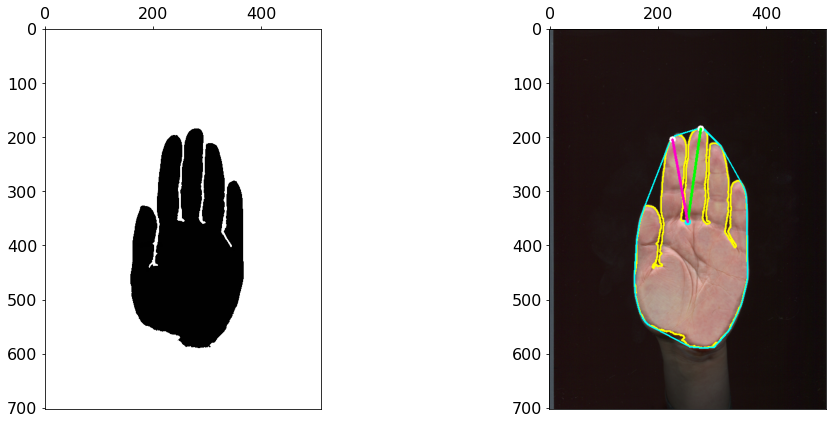

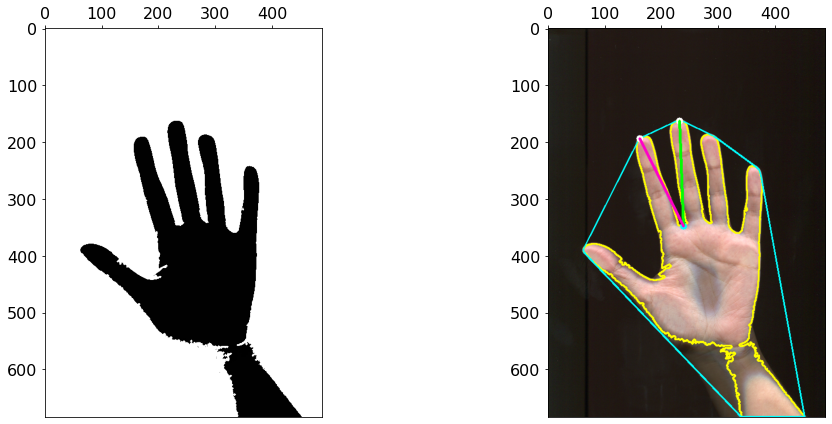

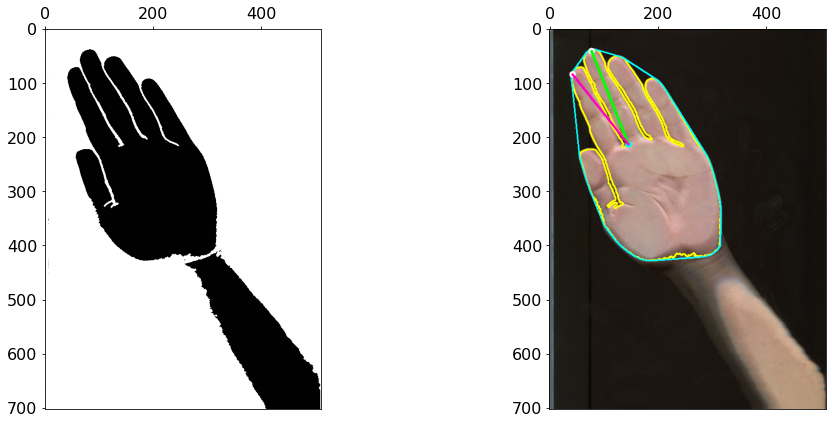

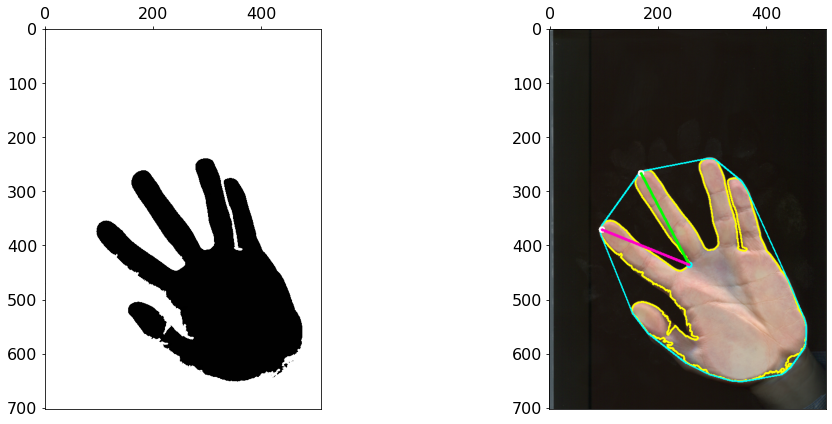

In [564]:
for img in src_images2:
    img = np.copy(img)
    mask = get_mask2(img)
    get_points2(img, mask)

In [ ]:
font_scale = 1
font = cv2.FONT_HERSHEY_DUPLEX
# opacity_text_bg = 0.75

fig_text = f'{k+1}'
text_width, text_height = cv2.getTextSize(fig_text, font, fontScale=font_scale, thickness=1)[0]
text_offset_x, text_offset_y = center_coords
box_coords = ((text_offset_x + 2, text_offset_y + 2),
              (text_offset_x + text_width + 2, text_offset_y - text_height - 2))
# overlay = main_img.copy()
cv2.rectangle(overlay, box_coords[0], box_coords[1], (255, 255, 255), cv2.FILLED)
# cv2.addWeighted(overlay, opacity_text_bg, main_img, 1 - opacity_text_bg, 0, main_img)
cv2.putText(main_img, fig_text, (text_offset_x, text_offset_y),
            font, fontScale=font_scale, color=(0, 0, 0), thickness=1)

In [562]:
src_images2 = []
for img in src_images:
    img = np.copy(img)
    src_images2.append(img[:, ::-1, :])

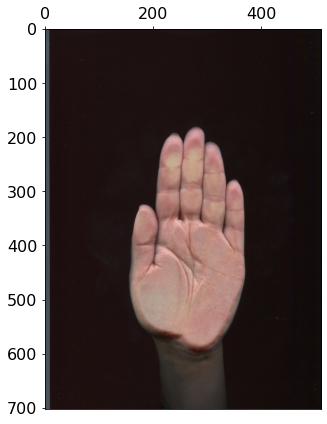

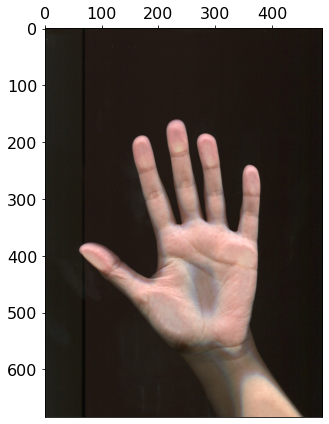

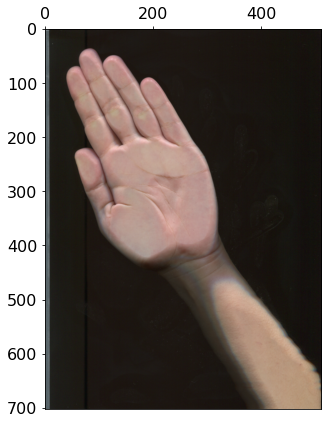

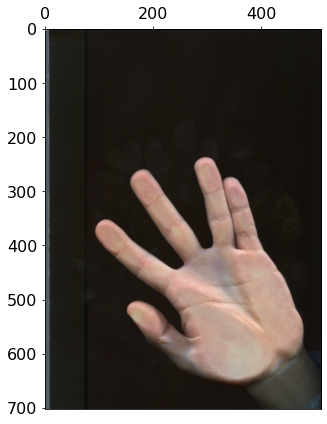

In [563]:
for img in src_images2:
    show_images([img])

In [559]:
def get_new_inds(i_first, right_arm):
    t_inds = list(range(5))
    v_inds = list(range(4))
    
    if right_arm:
        if i_first != 0:
            v_inds = v_inds[i_first:] + v_inds[:i_first]
            t_inds = t_inds[i_first + 1:] + t_inds[:i_first + 1]
    else:
        if i_first != 0:
            v_inds = v_inds[i_first:] + v_inds[:i_first]
            t_inds = t_inds[i_first:] + t_inds[:i_first]
        v_inds = [v_inds[(4 - i) % 4] for i in range(4)]
        t_inds = (t_inds[2:] + t_inds[:2])[::-1]
    
    return t_inds, v_inds

get_new_ind('b', 3)

([4, 3, 2, 1, 0], [3, 2, 1, 0])

In [539]:
a = [1, 2, 3, 4]
a[:0]

[]

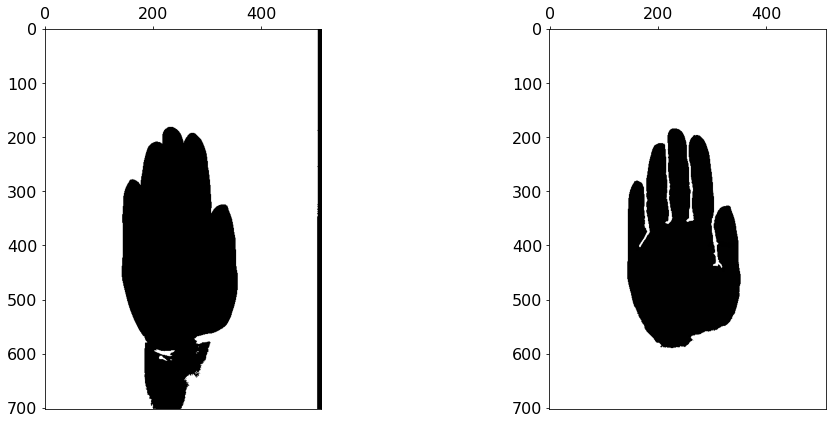

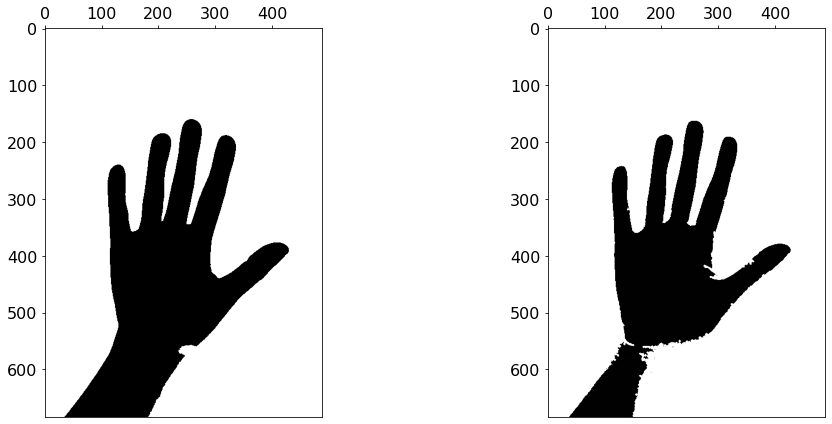

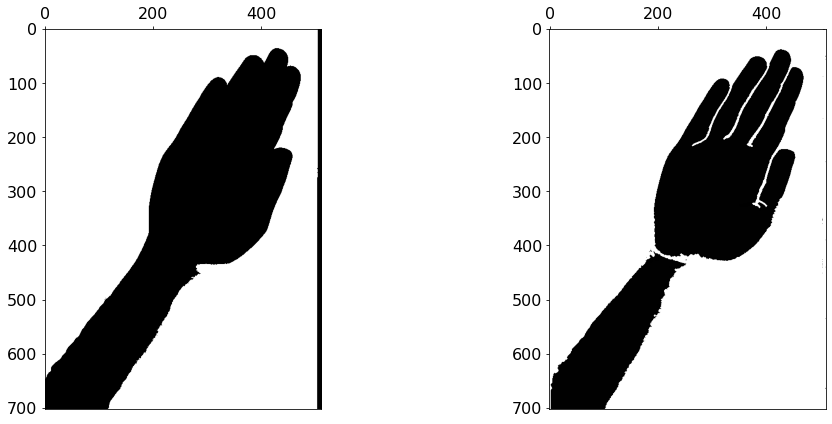

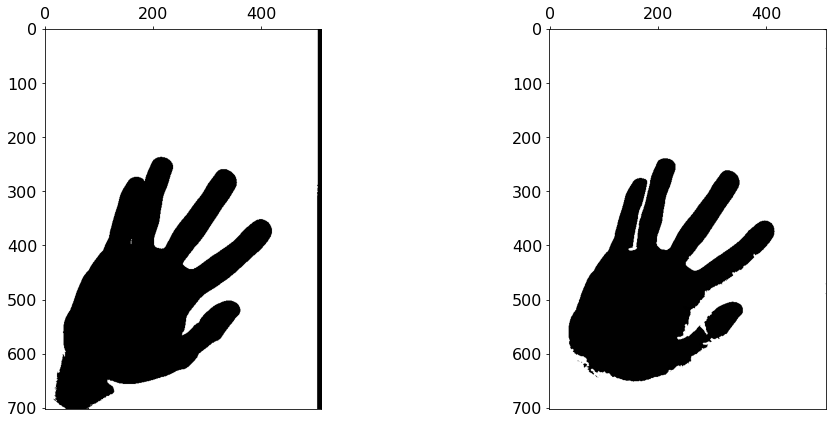

In [669]:
def get_mask1(img):
#     img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img = to_1ch(img, 'r')
    img = cv2.threshold(img, 50, 255, cv2.THRESH_BINARY)[1] > 0
#     img = to_bin(img) > 0
    img = remove_small_objects(img, 1200, connectivity=2)
    return img

for img in src_images:
    img = np.copy(img)
    mask1 = get_mask1(img)
    mask2 = get_mask2(img)
    show_images([mask1, mask2])

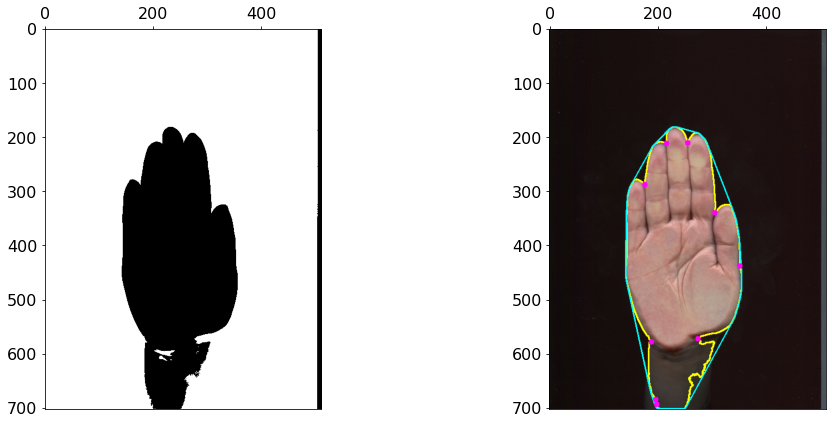

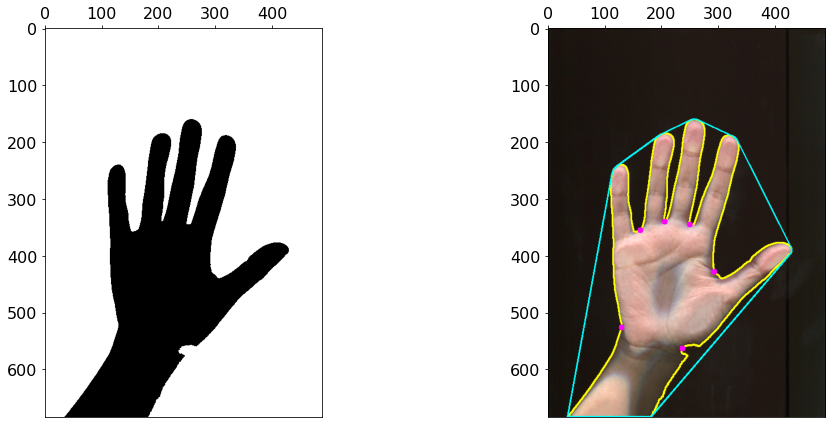

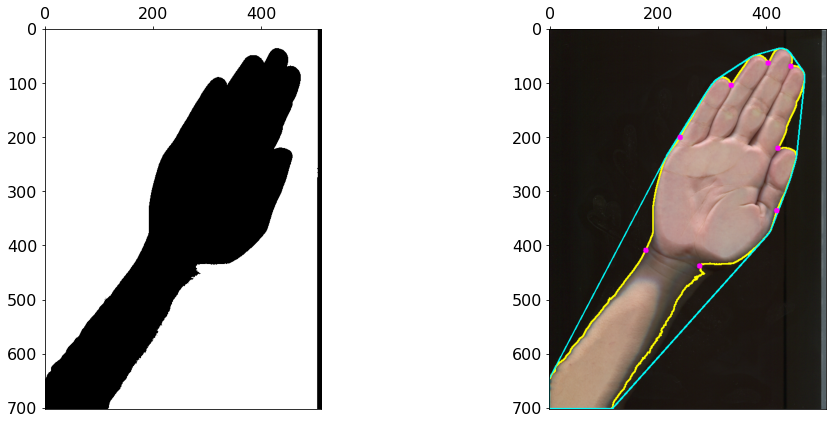

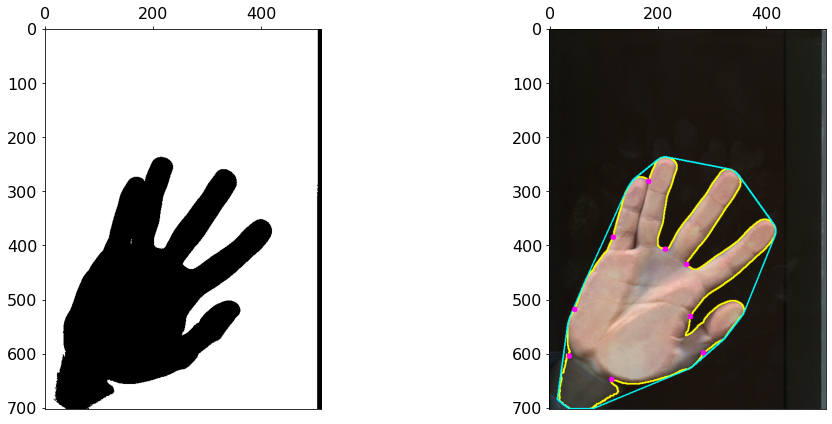

In [319]:
def get_points3(img, mask):
    main_img = img.copy()
    main_mask = mask.copy()
    main_mask = to_bin_uint8(main_mask)

    contours, _ = cv2.findContours(main_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)[-2:]
    contour = contours[np.argmax([len(contour) for contour in contours])]
    cv2.drawContours(main_img, [contour], 0, [255, 255, 0], 2)

    hull = cv2.convexHull(contour, clockwise=True,)
    cv2.drawContours(main_img, [hull], 0, [0, 255, 255], 2)

    hull_inds = cv2.convexHull(contour, clockwise=True, returnPoints=False)
    defects = cv2.convexityDefects(contour, hull_inds)


    points_arr = []
    for i in range(defects.shape[0]):
        s,e,f,d = defects[i,0]
    #     print(contour[s])
        start = tuple(contour[s][0])
        end = tuple(contour[e][0])
        far = tuple(contour[f][0])
    #     cv2.line(main_img,start,end,[0,255,0],2)
    #     cv2.circle(main_img,far,6,[255,0,0],-1)
#         cv2.circle(main_img,start,6,[255,0,0],-1)
#         cv2.circle(main_img,end,6,[0,0,255],-1)
#         cv2.circle(main_img,far,6,[255,0,255],-1)
#         print(d)
        if d > 500:
            points_arr.append((d, start, end, far))
    #     cv2.line(main_img,start,far,[255,255,255],3)
    #     cv2.line(main_img, far,end,[255,255,255],2)

    #     a = 

#         a = np.sqrt((end[0] - start[0]) ** 2 + (end[1] - start[1]) ** 2)
#         b = np.sqrt((far[0] - start[0]) ** 2 + (far[1] - start[1]) ** 2)
#         c = np.sqrt((end[0] - far[0]) ** 2 + (end[1] - far[1]) ** 2)
#         angle = np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))  # cosine theorem
#         if angle <= np.pi / 2:  # angle less than 90 degree, treat as fingers
#             points_arr.append((d, start, end, far))
    #     show_images([main_img])
    #     assert 1==0
    

    
    l = 4
#     points_arr = sorted(points_arr, key=lambda x: x[0])[-4:]
    contour = contour[:, 0, :]
    points_arr = sorted(points_arr, key=lambda x: get_point_ind(contour, np.array(x[1])))
    for points in points_arr:
        far = points[3]
        cv2.circle(main_img, far, 5, [255, 0, 255], -1)

    show_images([mask, main_img])
    return

        
    new_points = []
    sign = +1
    dist_arr = [dist(points_arr[i][1], points_arr[(i - 1) % l][2]) for i in range(l)]
    i_farest = np.argmax(dist_arr)
    

    for i in range(l):
        start, end = points_arr[i][1], points_arr[i][2]
        print(f'ind: {get_point_ind(contour, np.array(end))}')
        c = 255 * (i + 1) * 0.25
#         cv2.circle(main_img,start,6,[c,0,0],-1)
#         cv2.circle(main_img,end,6,[0,0,c],-1)

        
        cur_start, prev_end = points_arr[i][1], points_arr[(i - 1) % l][2]
        if i == i_farest:
            new_points.append(prev_end)
            new_points.append(cur_start)
        else:
            new_points.append(np.mean([cur_start, prev_end], axis=0).astype(np.int32))
#             cv2.circle(main_img,cur_start,6,[255,0,0],-1)
#             cv2.circle(main_img,prev_end,6,[0,0,255],-1)
        
    for new_point in new_points:
        cv2.circle(main_img,tuple(new_point),6,[255,255,255],-1)
    show_images([mask, main_img])

for img in src_images:
    img = np.copy(img)
    mask = get_mask1(img)
    get_points3(img, mask)

=====================

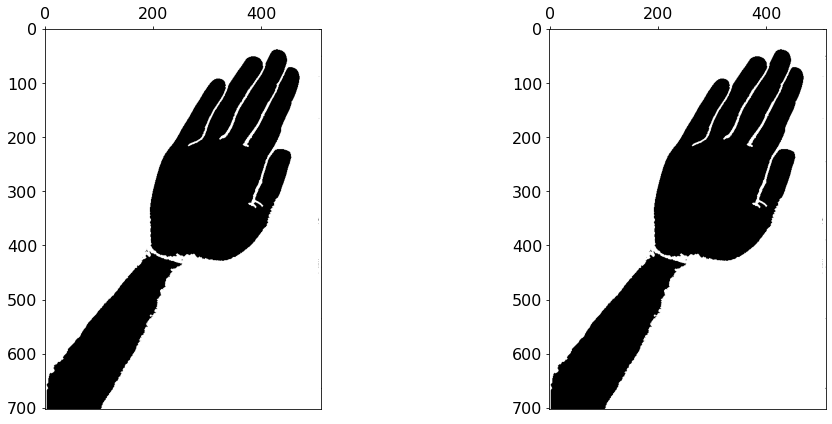

In [50]:
img = np.copy(src_images[2])
mask = (get_mask_1(img) + get_mask_2(img)) > 0
show_images([mask, binary_fill_holes(mask, disk(1))])

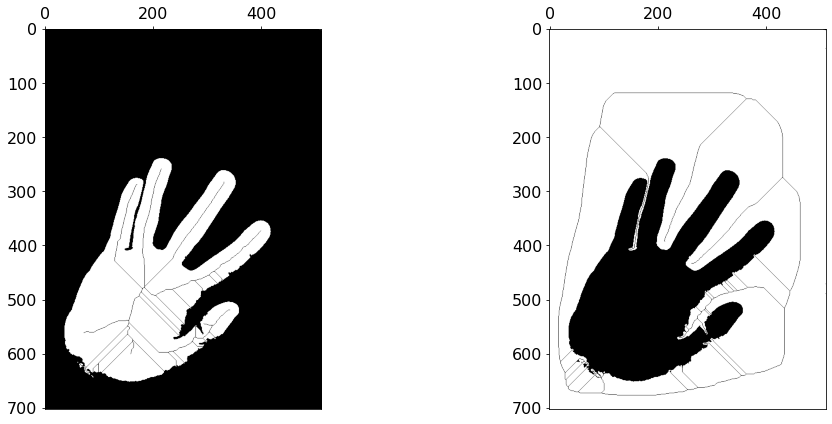

In [69]:
img = np.copy(img)
mask = (get_mask_1(img) + get_mask_2(img)) > 0
inv_mask = invert(mask) > 0

skel = skimage.morphology.skeletonize(mask)
inv_skel = skimage.morphology.skeletonize(inv_mask)

show_images([inv_mask + skel, mask + inv_skel])

# Better!

=====0=====


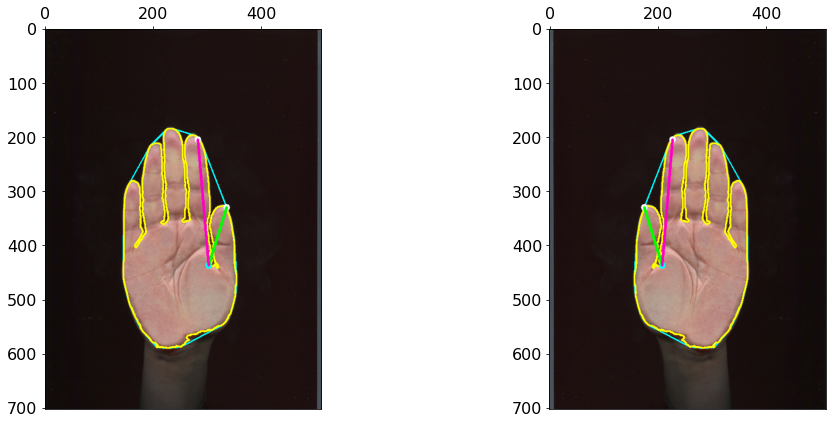

=====1=====


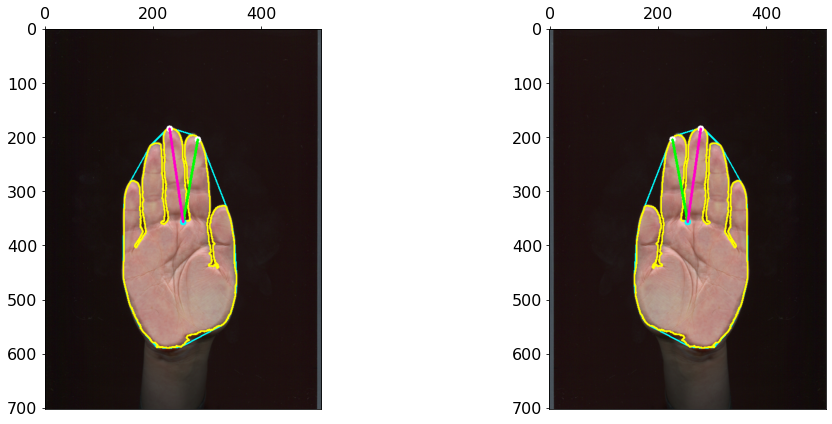

=====2=====


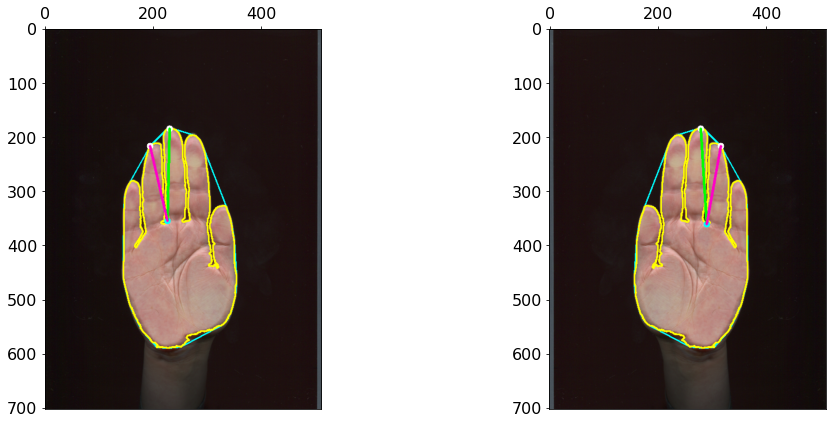

=====3=====


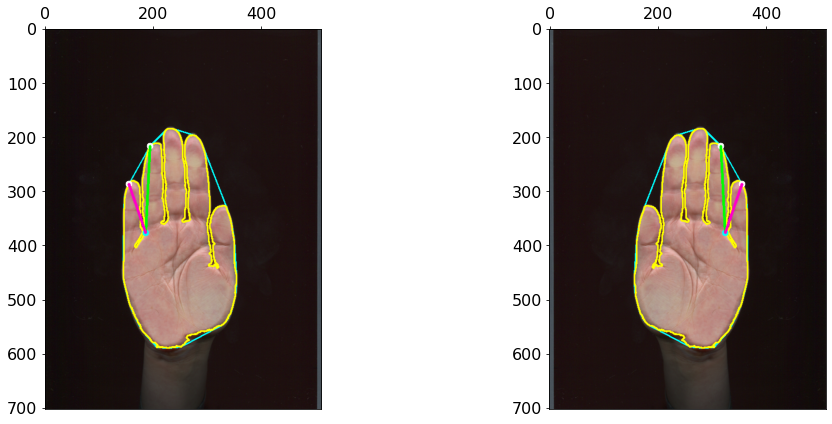

=====0=====


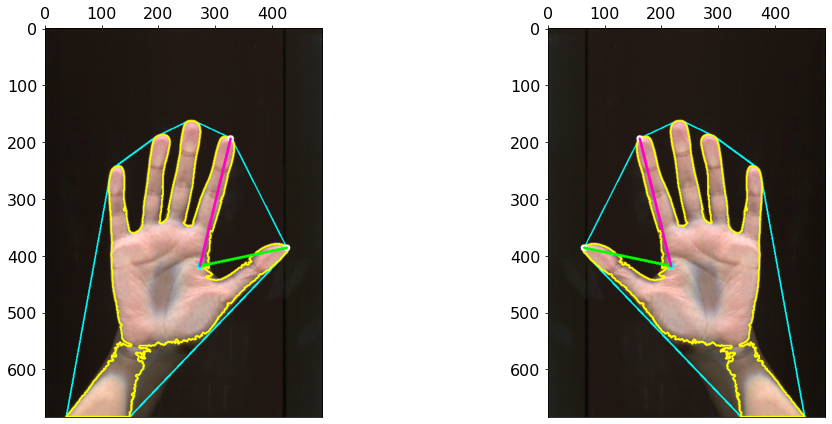

=====1=====


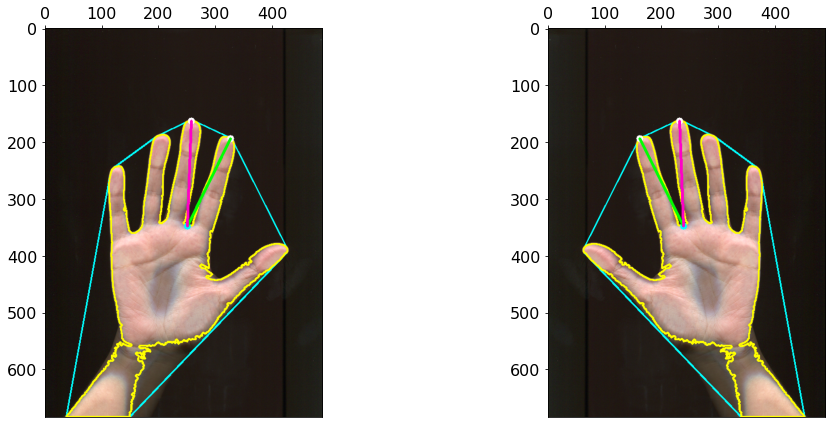

=====2=====


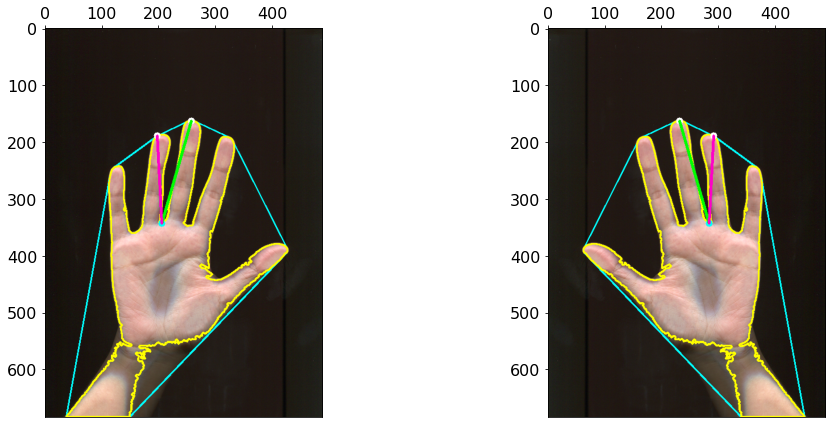

=====3=====


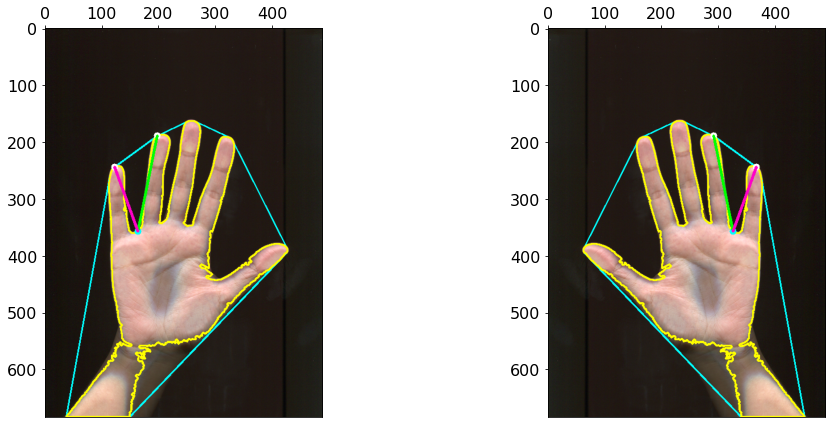

=====0=====


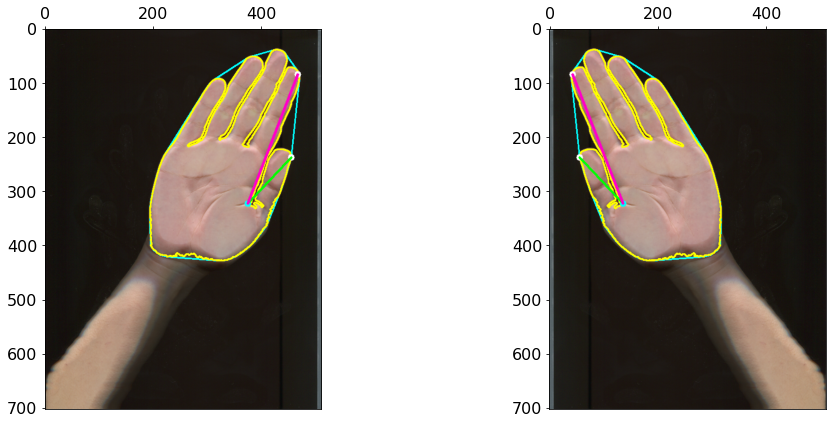

=====1=====


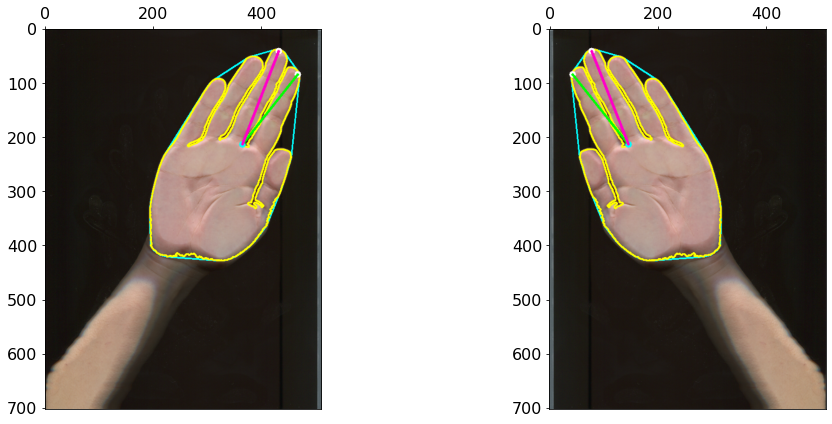

=====2=====


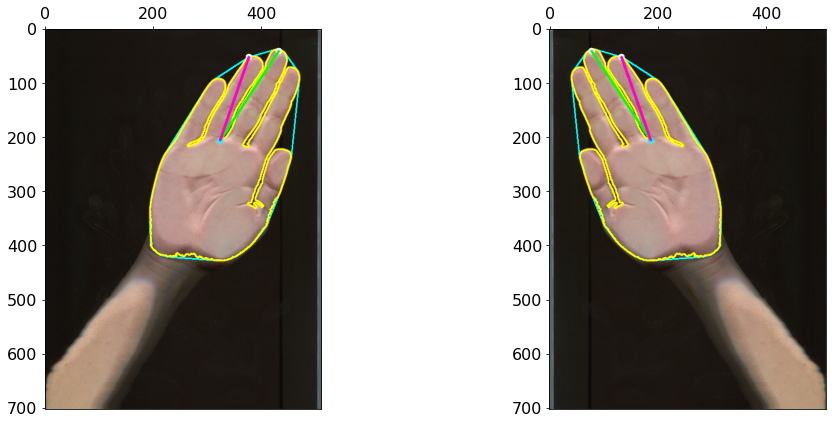

=====3=====


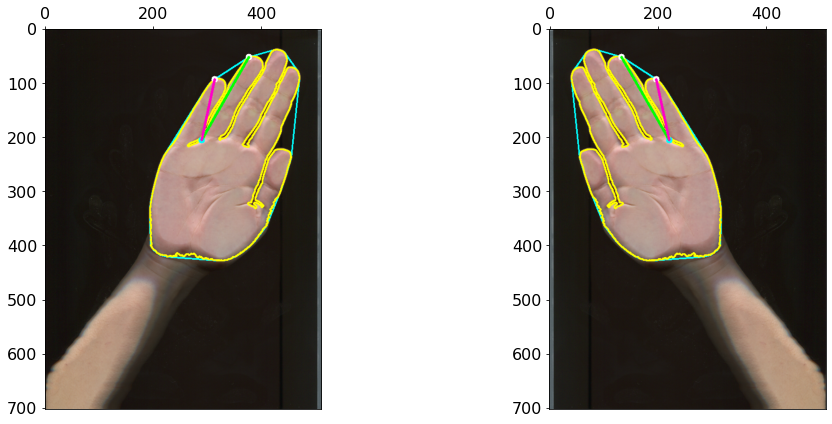

=====0=====


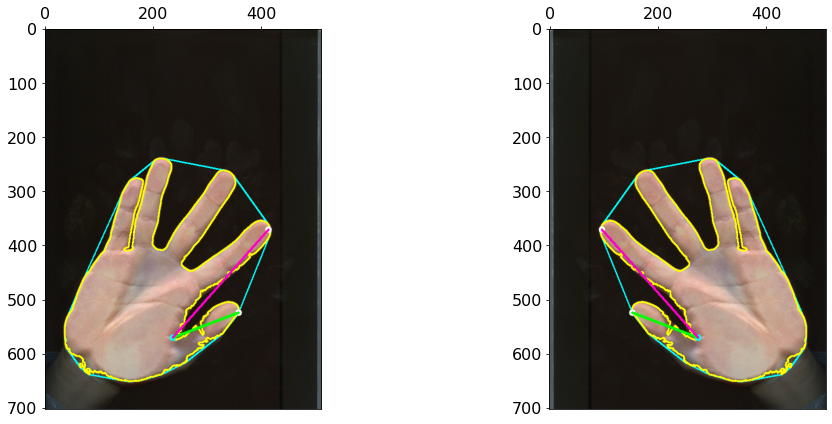

=====1=====


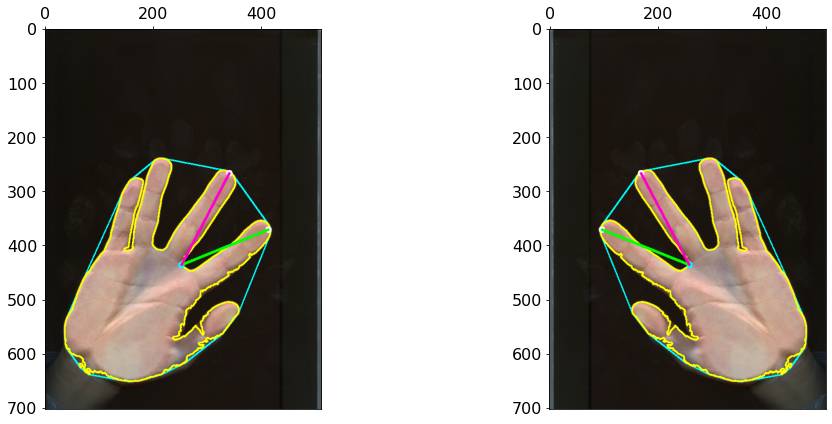

=====2=====


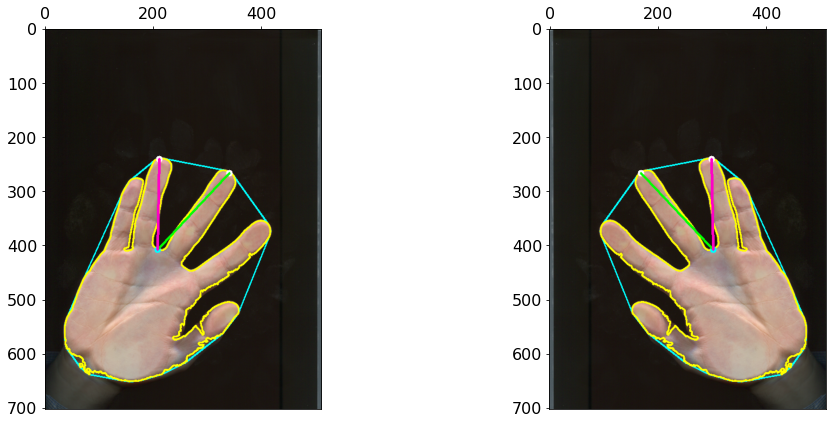

=====3=====


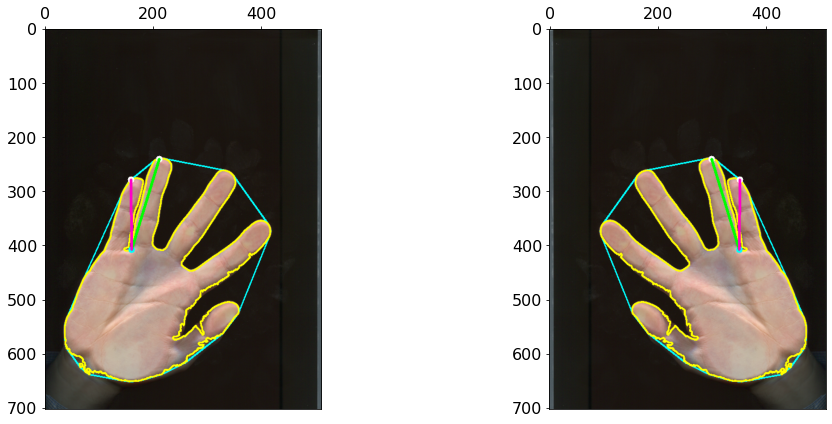

In [668]:
def get_dist(p1, p2):
    p1, p2 = np.array(p1), np.array(p2)
    return np.sqrt(np.sum((p1 - p2)**2, axis=-1))
        
def get_angle(p1, p2, p3):
    a, b, c = (np.sqrt(np.sum((p3 - p1) ** 2, axis=-1)),
               np.sqrt(np.sum((p2 - p1) ** 2, axis=-1)),
               np.sqrt(np.sum((p2 - p3) ** 2, axis=-1)))
    return np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))

def get_point_ind(arr, point):
    arr = sorted(np.argwhere(arr == point), key=lambda x: x[0])
    l = len(arr)
    for i in range(l - 1):
        if arr[i][0] == arr[i+1][0]:
            return arr[i][0]

def get_points2(img, mask, k):
    img = np.copy(img)
    mask = to_bin_uint8(mask)
    n_tips = 5
    n_valleys = 4

    # construction of a contour and a convex hull with convex defects
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[-2:]
    contour = contours[np.argmax([len(contour) for contour in contours])][:, 0, :]
    hull = cv2.convexHull(contour)
    hull_inds = cv2.convexHull(contour, returnPoints=False)
    defects = cv2.convexityDefects(contour, hull_inds)
    
    cv2.drawContours(img, [hull], 0, [0, 255, 255], 2)
    cv2.drawContours(img, [contour], 0, [255, 255, 0], 2)

    # filtering convex defects by angle
    points_arr = []
    for i in range(defects.shape[0]):
        s,e,f,d = defects[i,0]
        start, end, far = contour[s], contour[e], contour[f]
        if get_angle(start, far, end) <= np.pi / 2:
            points_arr.append([d, start, end, far])
    
    # filtering convex defects by depth
    points_arr = sorted(points_arr, key=lambda x: x[0])[-4:]
    
    # sorting convex defects in order of contour
    points_arr = sorted(points_arr, key=lambda x:
                        get_point_ind(contour, np.array(x[1])))
    
    # evaluating tips and collecting valleys
    points_arr = np.array([points[1:] for points in points_arr])
    start_arr, end_arr = points_arr[:, 0, :], points_arr[:, 1, :]
    dist_arr = [dist(start_arr[i], end_arr[(i - 1) % n_valleys])
                for i in range(n_valleys)]
    farest_tips_ind = np.argmax(dist_arr)
    tips, valleys = [], points_arr[:, 2, :]
    for i in range(n_valleys):
        cur_start, prev_end = start_arr[i], end_arr[(i - 1) % n_valleys]
        if i == farest_tips_ind:
            tips.append(prev_end)
            tips.append(cur_start)
        else:
            tips.append(np.mean([cur_start, prev_end], axis=0).astype(np.int32))
    
    # finding max finger-line 'valley-tip' for palm orientation
    line_lens = []
    for i in range(n_valleys):
        j = i + 1 if i >= farest_tips_ind else i
        v_point, t_point_1, t_point_2 = (valleys[i], tuple(tips[j]),
                                         tuple(tips[(j + 1) % n_tips]))
        line_lens.append([dist(v_point, t_point_1), dist(v_point, t_point_2)])
    max_line_ind = np.argmax(np.array(line_lens).ravel())
    
    # palm orientation
    palm_orient = 'r' if max_line_ind % 2 else 'l'
    first_ind = max_line_ind // 2
    
    # sorting tips and valleys in normal order
    t_inds, v_inds = list(range(n_tips)), list(range(n_valleys))
    if palm_orient == 'r':
        if first_ind != 0:
            v_inds = v_inds[first_ind:] + v_inds[:first_ind]
            t_inds = t_inds[first_ind + 1:] + t_inds[:first_ind + 1]
    elif palm_orient == 'l':
        if first_ind != 0:
            v_inds = v_inds[first_ind:] + v_inds[:first_ind]
            t_inds = t_inds[first_ind:] + t_inds[:first_ind]
        v_inds = [v_inds[(n_valleys - i) % n_valleys] for i in range(n_valleys)]
        t_inds = (t_inds[2:] + t_inds[:2])[::-1]
    else:
        raise RuntimeError(f'Wrong palm orientation {palm_orient}!')
    tips = np.array([tips[ind] for ind in t_inds])
    valleys = np.array([valleys[ind] for ind in v_inds])

    for i in range(k, k + 1):
        v_point, t_point_1, t_point_2 = list(map(lambda x: tuple(x),
                                                 [valleys[i], tips[i], tips[i + 1]]))
        
        cv2.circle(img,v_point,6,[0,255,255],-1)
        cv2.circle(img,t_point_1,6,[255,255,255],-1)
        cv2.circle(img,t_point_2,6,[255,255,255],-1)
        
        cv2.line(img, v_point, t_point_1, [0,255,0], 3)
        cv2.line(img, v_point, t_point_2, [255,0,200], 3)
#     show_images([mask, img])
    return img


def get_mask2(img):
    return get_mask_1(img) + get_mask_2(img)

for img1, img2 in zip(src_images, src_images2):
    img1 = np.copy(img1)
    img2 = np.copy(img2)

    for k in [0, 1, 2, 3]:
        print(f'====={k}=====')
#         get_points2(img1, get_mask2(img1), k)
#         assert 0 == 1
        show_images([get_points2(img1, get_mask2(img1), k),
                     get_points2(img2, get_mask2(img2), k)])

In [646]:
arrr

[[17783,
  array([334, 330], dtype=int32),
  array([289, 214], dtype=int32),
  array([301, 437], dtype=int32)],
 [18146,
  array([193, 217], dtype=int32),
  array([154, 287], dtype=int32),
  array([185, 377], dtype=int32)],
 [30773,
  array([224, 186], dtype=int32),
  array([193, 217], dtype=int32),
  array([225, 355], dtype=int32)]]

In [655]:
arrr2 = [el[1:] for el in arrr]

In [661]:
arrr3 = np.array(arrr2)

In [662]:
arrr3.shape

(3, 3, 2)

In [663]:
arrr3[:, 0, :]

array([[334, 330],
       [193, 217],
       [224, 186]], dtype=int32)